<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_crop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [10]:
len(X_train)

919

In [25]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [13]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [14]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [26]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [16]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [17]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
callbacks_list = [
    ShowTestImages()
]

In [21]:
effnet = EfficientNetB0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = tf.keras.layers.Flatten()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

16705208/16705208 [==============================] - 0s 0us/step


In [22]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/100
8/8 [==============================] - 0s 37ms/step


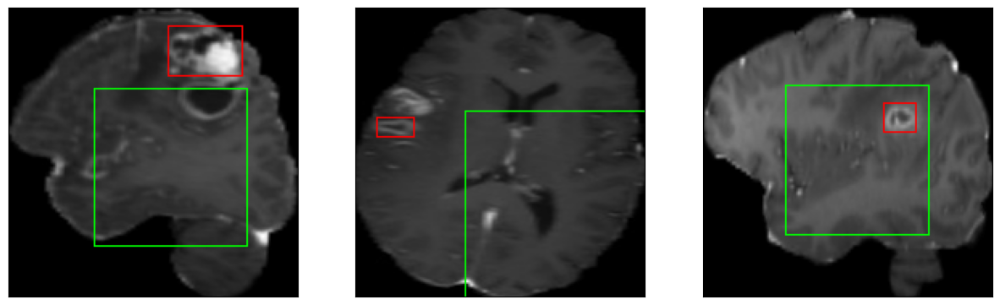

52/52 [==============================] - 68s 238ms/step - loss: 51.4707 - IoU: 9.1717e-04 - val_loss: 58.9547 - val_IoU: 0.0641
Epoch 2/100
8/8 [==============================] - 0s 39ms/step


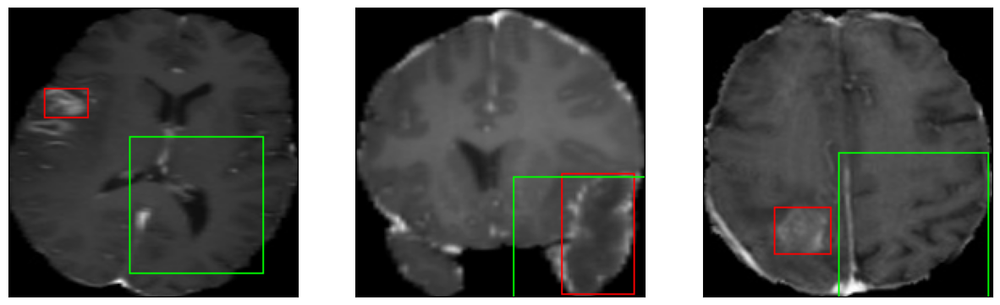

52/52 [==============================] - 7s 137ms/step - loss: 28.3268 - IoU: 0.0499 - val_loss: 62.2852 - val_IoU: 0.0243
Epoch 3/100
8/8 [==============================] - 0s 38ms/step


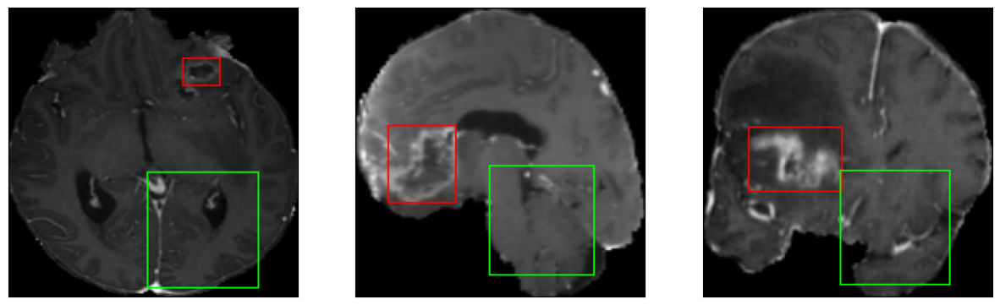

52/52 [==============================] - 7s 133ms/step - loss: 20.4679 - IoU: 0.1079 - val_loss: 37.4722 - val_IoU: 0.0261
Epoch 4/100
8/8 [==============================] - 0s 44ms/step


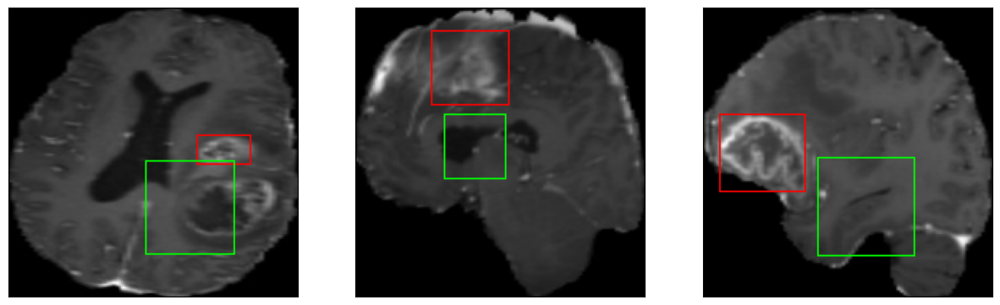

52/52 [==============================] - 9s 178ms/step - loss: 18.0835 - IoU: 0.1274 - val_loss: 21.5756 - val_IoU: 0.0813
Epoch 5/100
8/8 [==============================] - 0s 45ms/step


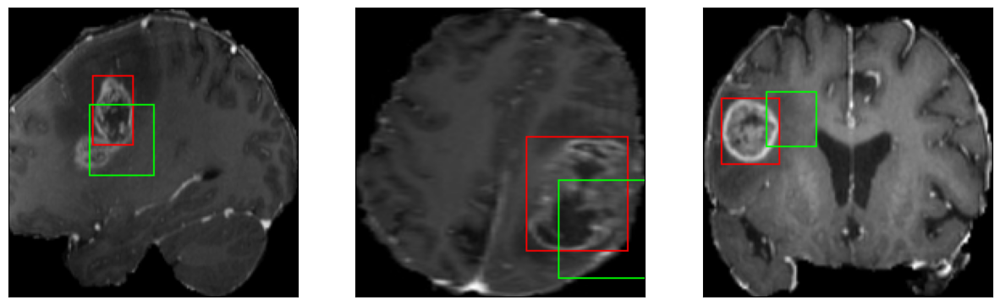

52/52 [==============================] - 12s 226ms/step - loss: 15.1427 - IoU: 0.1882 - val_loss: 13.6576 - val_IoU: 0.2373
Epoch 6/100
8/8 [==============================] - 0s 47ms/step


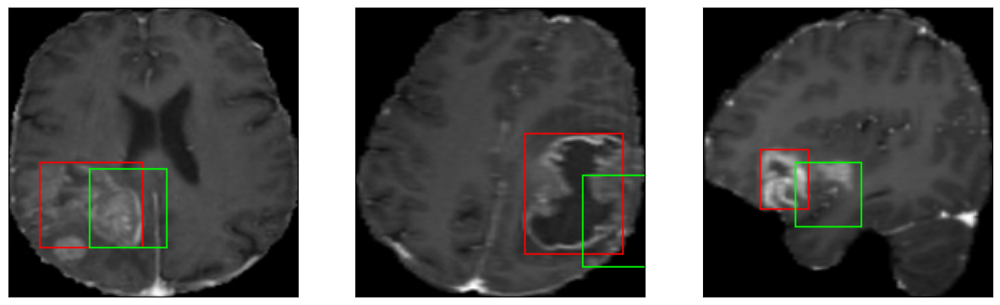

52/52 [==============================] - 11s 203ms/step - loss: 11.9001 - IoU: 0.2712 - val_loss: 12.8315 - val_IoU: 0.2269
Epoch 7/100
8/8 [==============================] - 0s 37ms/step


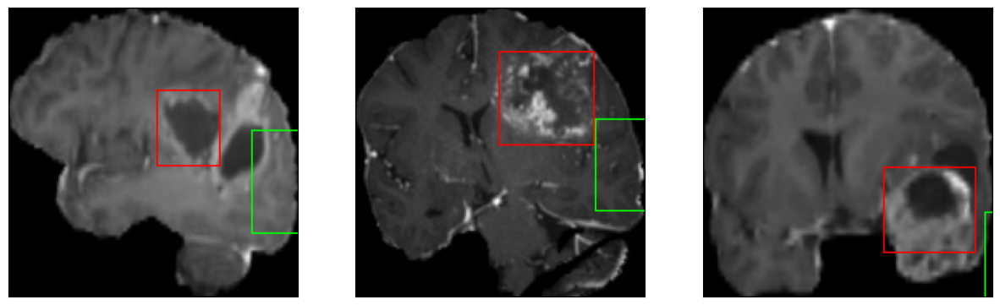

52/52 [==============================] - 8s 159ms/step - loss: 10.0256 - IoU: 0.3431 - val_loss: 21.1053 - val_IoU: 0.0793
Epoch 8/100
8/8 [==============================] - 0s 38ms/step


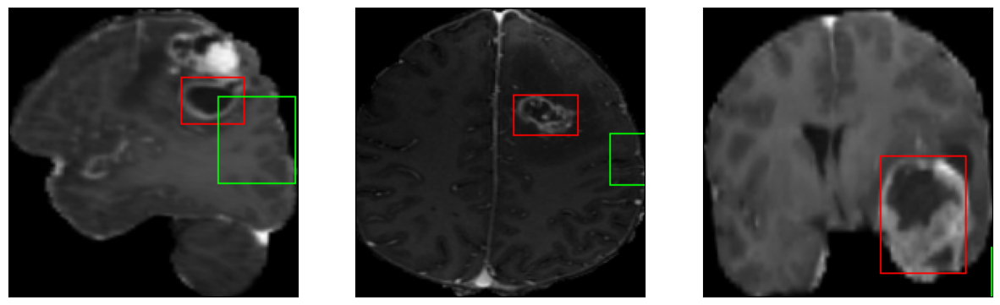

52/52 [==============================] - 10s 183ms/step - loss: 9.3758 - IoU: 0.3658 - val_loss: 23.5660 - val_IoU: 0.0741
Epoch 9/100
8/8 [==============================] - 0s 40ms/step


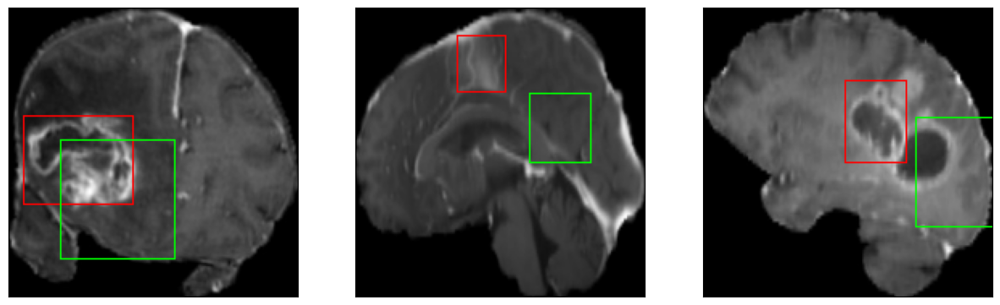

52/52 [==============================] - 12s 226ms/step - loss: 8.5483 - IoU: 0.4039 - val_loss: 18.1045 - val_IoU: 0.1544
Epoch 10/100
8/8 [==============================] - 0s 37ms/step


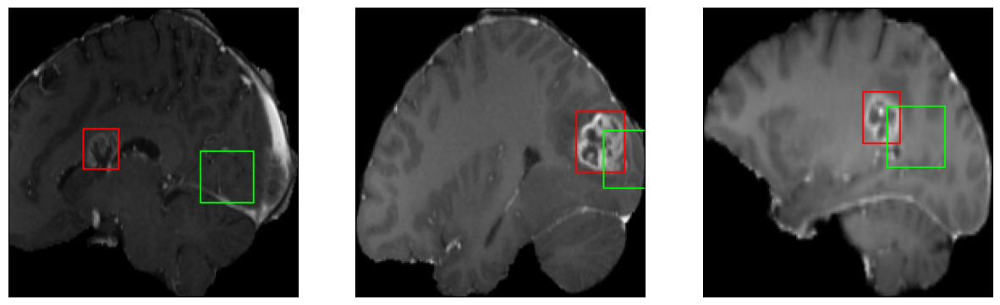

52/52 [==============================] - 7s 135ms/step - loss: 8.3376 - IoU: 0.4094 - val_loss: 13.9411 - val_IoU: 0.2214
Epoch 11/100
8/8 [==============================] - 0s 38ms/step


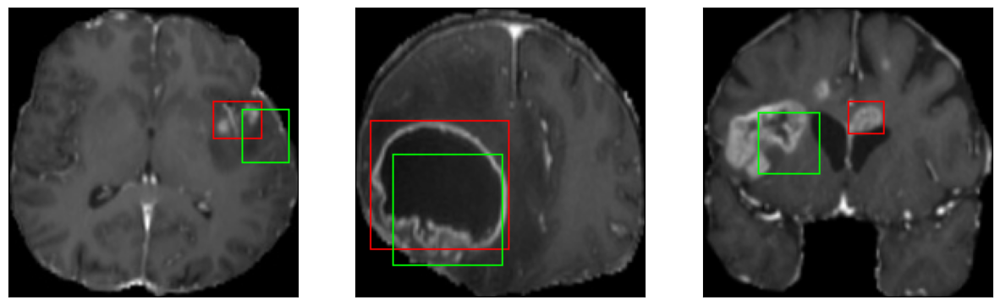

52/52 [==============================] - 7s 135ms/step - loss: 7.9045 - IoU: 0.4381 - val_loss: 9.8941 - val_IoU: 0.3679
Epoch 12/100
8/8 [==============================] - 0s 38ms/step


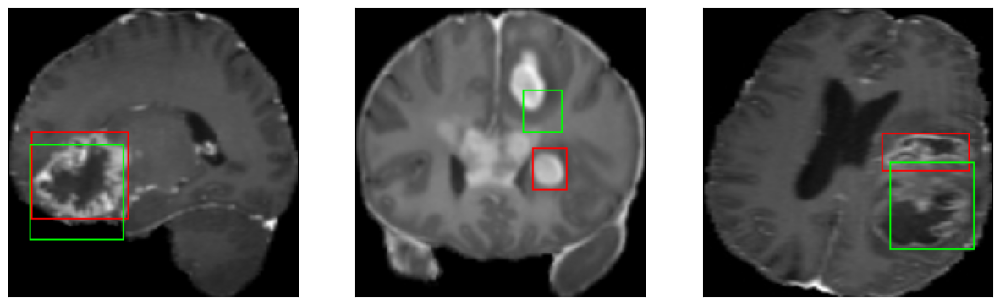

52/52 [==============================] - 8s 152ms/step - loss: 7.8994 - IoU: 0.4260 - val_loss: 8.6659 - val_IoU: 0.4444
Epoch 13/100
8/8 [==============================] - 0s 40ms/step


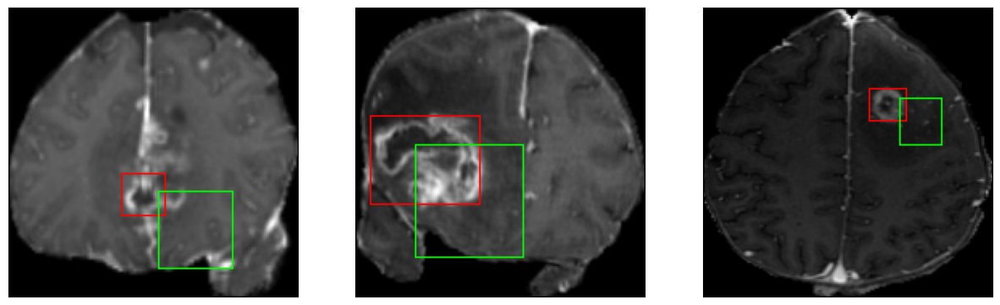

52/52 [==============================] - 7s 138ms/step - loss: 7.7865 - IoU: 0.4232 - val_loss: 16.9190 - val_IoU: 0.1493
Epoch 14/100
8/8 [==============================] - 0s 39ms/step


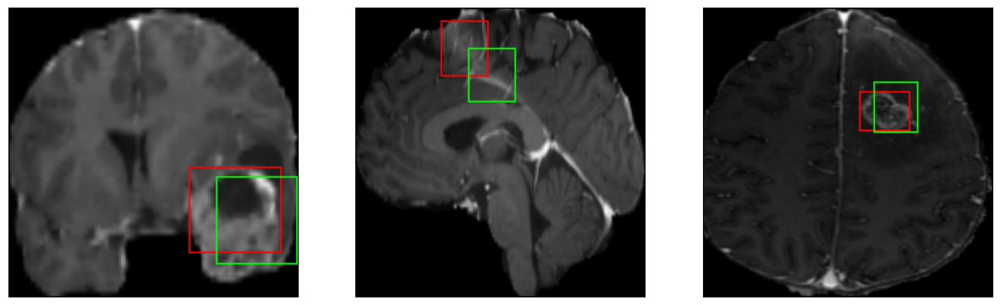

52/52 [==============================] - 8s 145ms/step - loss: 7.4637 - IoU: 0.4505 - val_loss: 9.1741 - val_IoU: 0.3990
Epoch 15/100
8/8 [==============================] - 0s 41ms/step


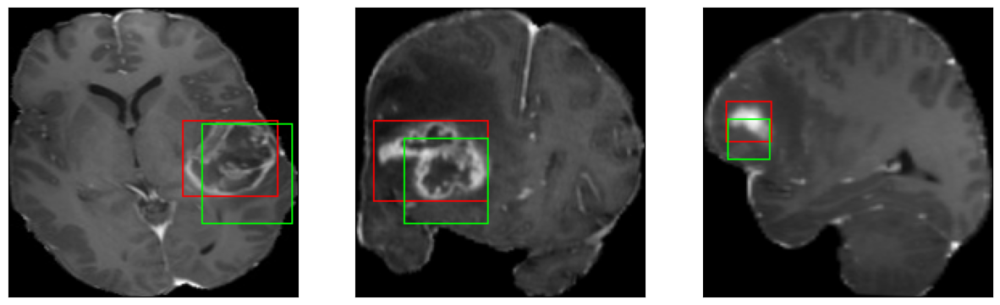

52/52 [==============================] - 8s 163ms/step - loss: 7.1997 - IoU: 0.4692 - val_loss: 9.2055 - val_IoU: 0.3603
Epoch 16/100
8/8 [==============================] - 0s 40ms/step


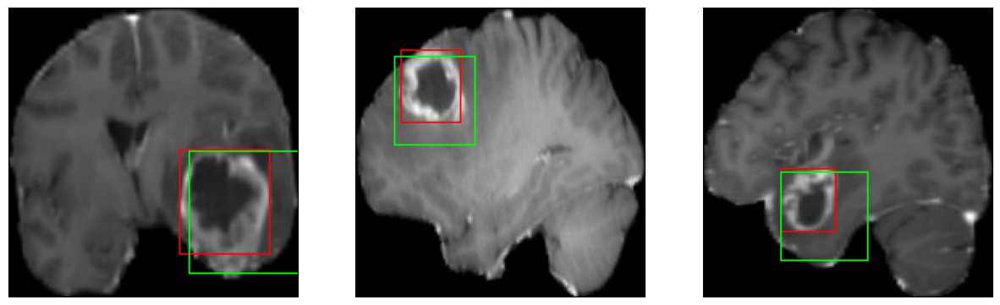

52/52 [==============================] - 7s 138ms/step - loss: 7.0726 - IoU: 0.4661 - val_loss: 11.5679 - val_IoU: 0.4006
Epoch 17/100
8/8 [==============================] - 0s 40ms/step


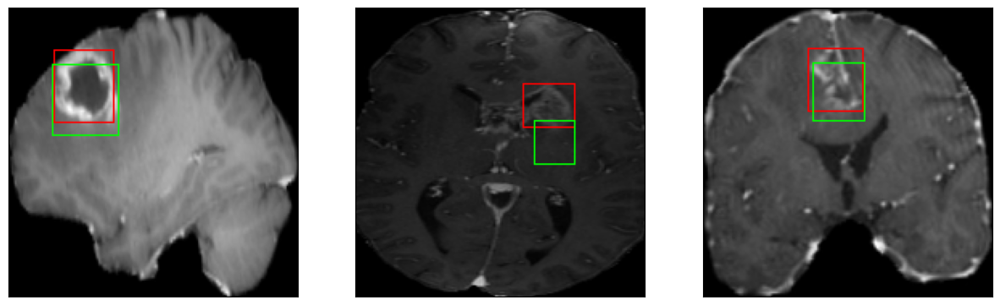

52/52 [==============================] - 8s 149ms/step - loss: 7.0254 - IoU: 0.4724 - val_loss: 9.7933 - val_IoU: 0.3636
Epoch 18/100
8/8 [==============================] - 0s 41ms/step


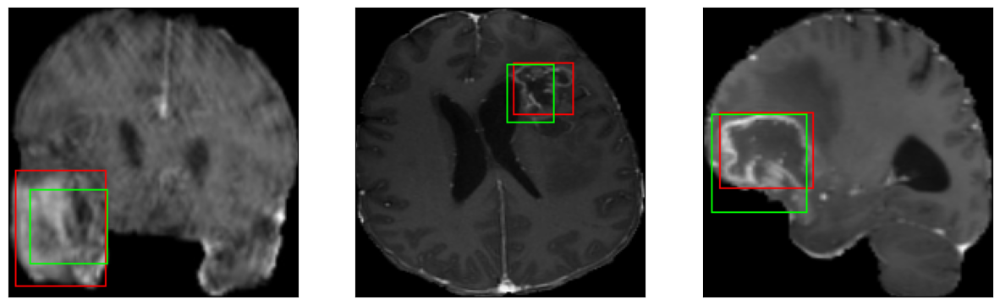

52/52 [==============================] - 8s 157ms/step - loss: 6.5443 - IoU: 0.5014 - val_loss: 7.1569 - val_IoU: 0.5062
Epoch 19/100
8/8 [==============================] - 0s 39ms/step


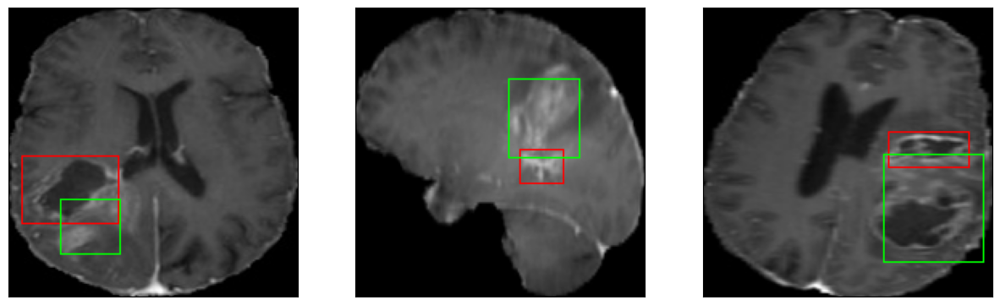

52/52 [==============================] - 7s 142ms/step - loss: 6.8745 - IoU: 0.4795 - val_loss: 7.7638 - val_IoU: 0.4854
Epoch 20/100
8/8 [==============================] - 0s 39ms/step


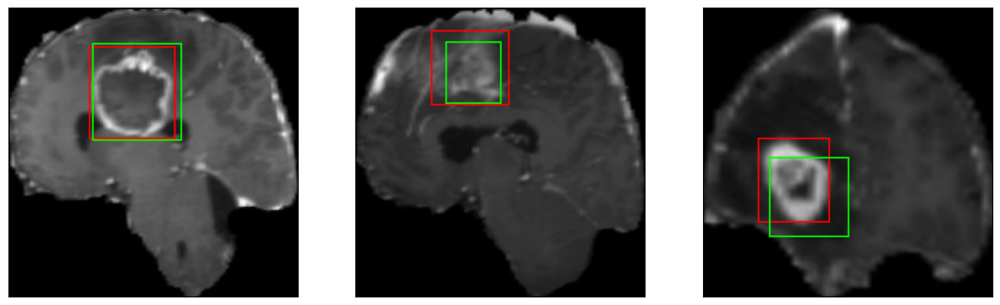

52/52 [==============================] - 8s 160ms/step - loss: 6.6403 - IoU: 0.4994 - val_loss: 9.6228 - val_IoU: 0.3799
Epoch 21/100
8/8 [==============================] - 0s 39ms/step


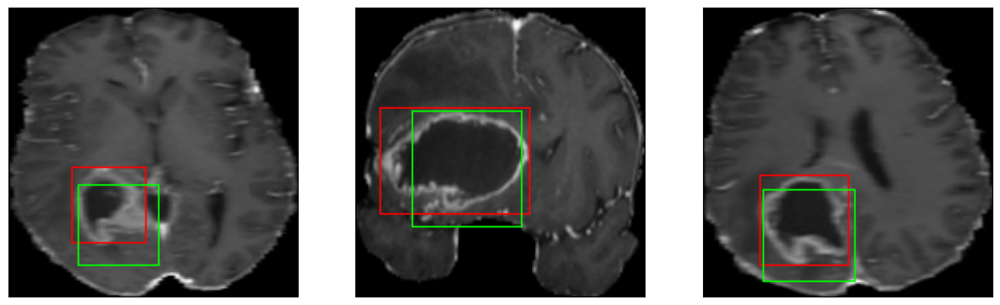

52/52 [==============================] - 7s 139ms/step - loss: 6.5262 - IoU: 0.5021 - val_loss: 8.6509 - val_IoU: 0.4480
Epoch 22/100
8/8 [==============================] - 0s 39ms/step


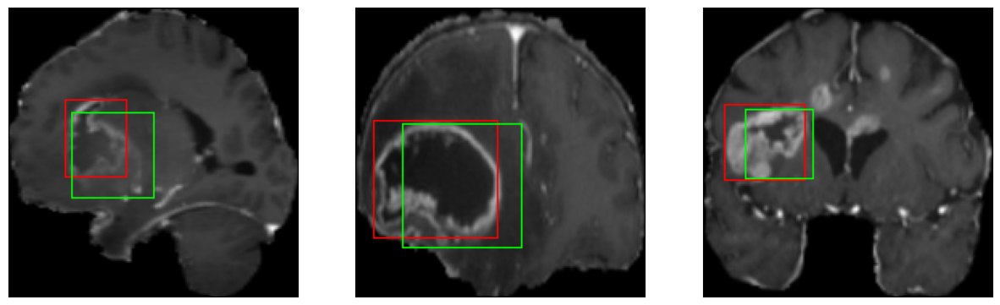

52/52 [==============================] - 8s 152ms/step - loss: 6.5149 - IoU: 0.5057 - val_loss: 8.5852 - val_IoU: 0.4665
Epoch 23/100
8/8 [==============================] - 0s 40ms/step


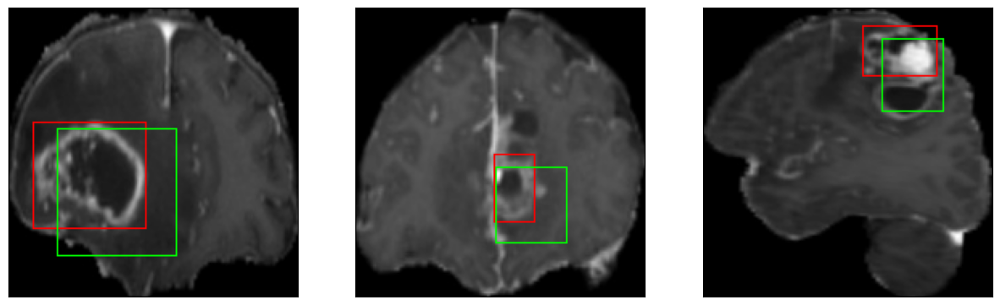

52/52 [==============================] - 8s 156ms/step - loss: 6.4868 - IoU: 0.5081 - val_loss: 11.0832 - val_IoU: 0.3532
Epoch 24/100
8/8 [==============================] - 0s 40ms/step


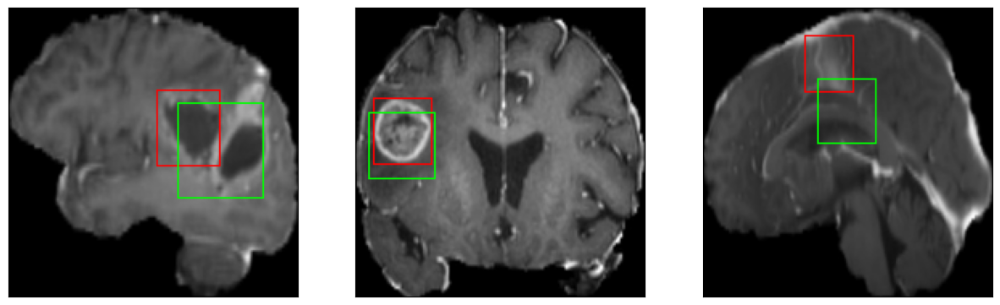

52/52 [==============================] - 8s 153ms/step - loss: 6.2981 - IoU: 0.5194 - val_loss: 8.4323 - val_IoU: 0.4547
Epoch 25/100
8/8 [==============================] - 0s 39ms/step


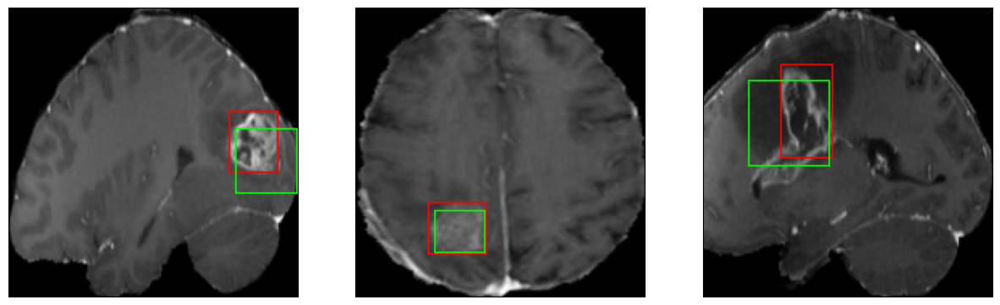

52/52 [==============================] - 9s 161ms/step - loss: 6.4207 - IoU: 0.5083 - val_loss: 8.0238 - val_IoU: 0.4397
Epoch 26/100
8/8 [==============================] - 0s 39ms/step


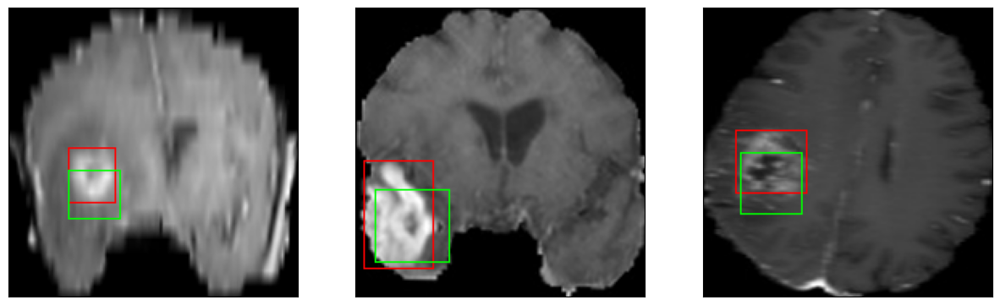

52/52 [==============================] - 7s 142ms/step - loss: 6.1543 - IoU: 0.5342 - val_loss: 7.7858 - val_IoU: 0.4844
Epoch 27/100
8/8 [==============================] - 0s 41ms/step


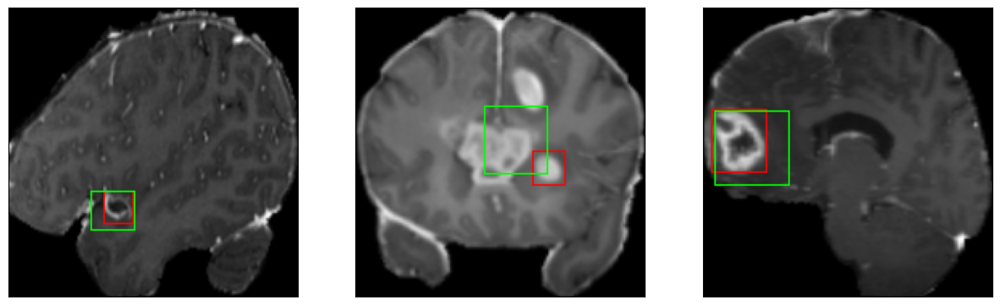

52/52 [==============================] - 9s 174ms/step - loss: 6.1101 - IoU: 0.5174 - val_loss: 8.8252 - val_IoU: 0.4934
Epoch 28/100
8/8 [==============================] - 0s 38ms/step


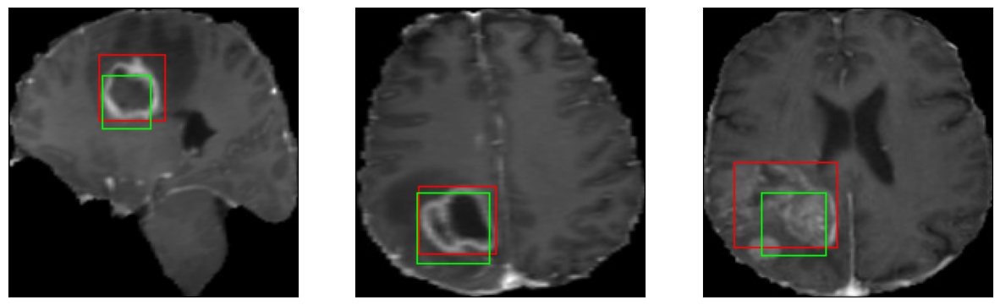

52/52 [==============================] - 7s 139ms/step - loss: 6.3312 - IoU: 0.5283 - val_loss: 7.3118 - val_IoU: 0.5121
Epoch 29/100
8/8 [==============================] - 0s 39ms/step


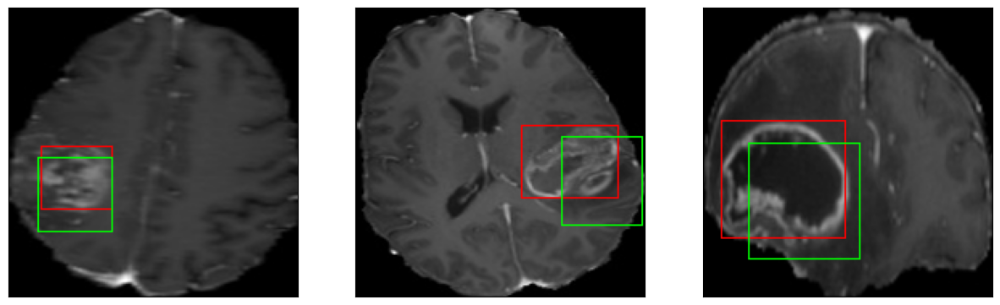

52/52 [==============================] - 8s 160ms/step - loss: 6.0409 - IoU: 0.5439 - val_loss: 9.4911 - val_IoU: 0.3771
Epoch 30/100
8/8 [==============================] - 0s 42ms/step


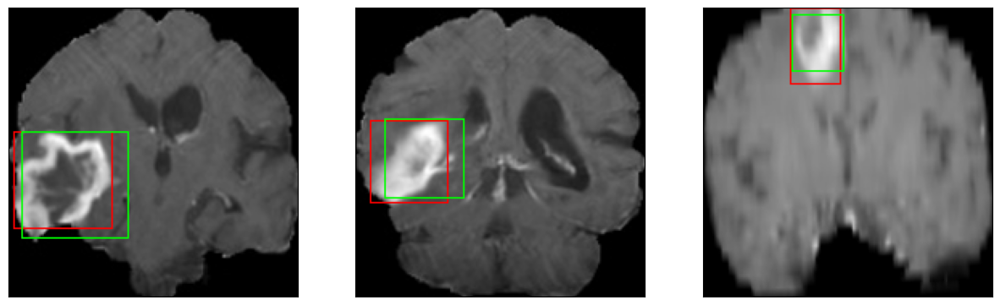

52/52 [==============================] - 8s 154ms/step - loss: 5.6760 - IoU: 0.5656 - val_loss: 7.4434 - val_IoU: 0.5556
Epoch 31/100
8/8 [==============================] - 0s 39ms/step


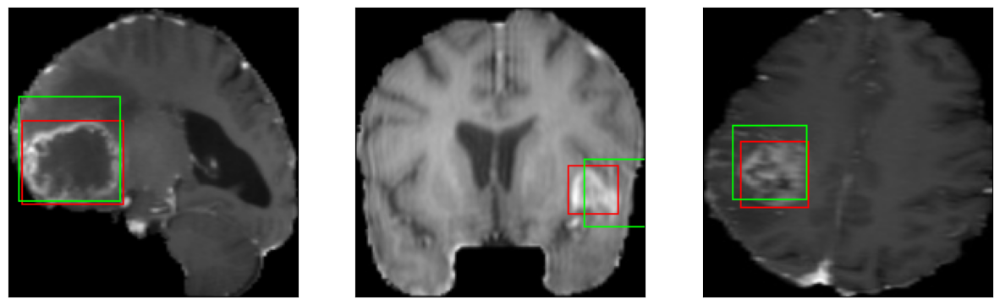

52/52 [==============================] - 8s 148ms/step - loss: 6.0398 - IoU: 0.5381 - val_loss: 7.9873 - val_IoU: 0.4620
Epoch 32/100
8/8 [==============================] - 0s 41ms/step


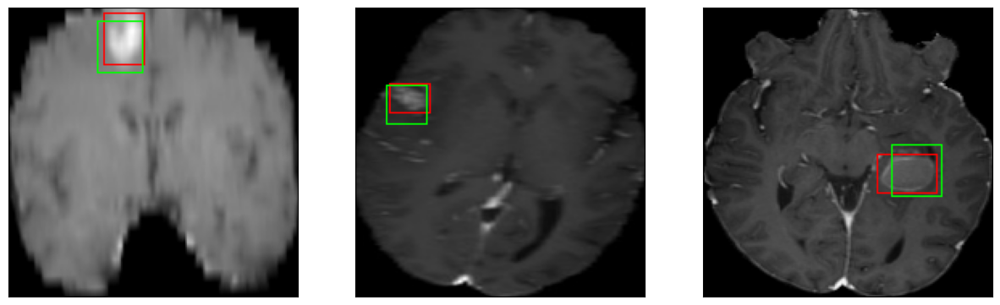

52/52 [==============================] - 8s 154ms/step - loss: 5.6826 - IoU: 0.5635 - val_loss: 7.5290 - val_IoU: 0.5550
Epoch 33/100
8/8 [==============================] - 0s 39ms/step


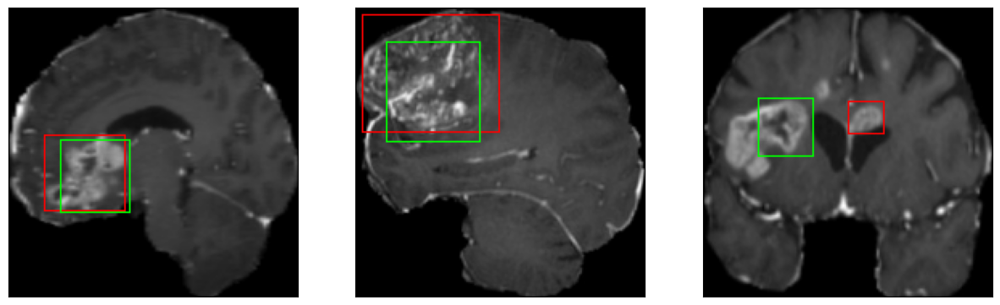

52/52 [==============================] - 7s 141ms/step - loss: 5.9807 - IoU: 0.5475 - val_loss: 8.0846 - val_IoU: 0.4601
Epoch 34/100
8/8 [==============================] - 0s 40ms/step


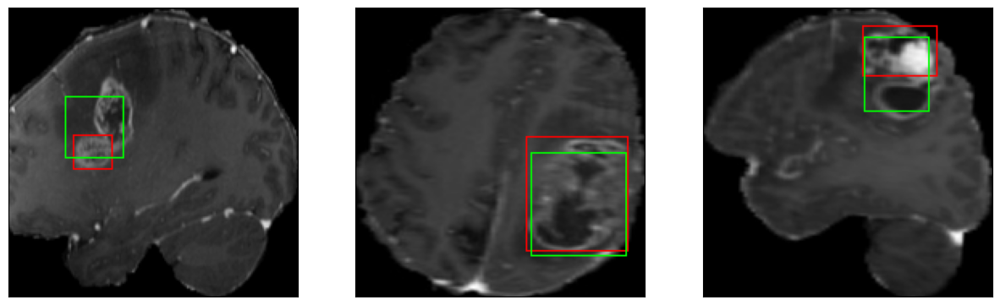

52/52 [==============================] - 8s 145ms/step - loss: 5.6424 - IoU: 0.5728 - val_loss: 7.3583 - val_IoU: 0.5338
Epoch 35/100
8/8 [==============================] - 0s 42ms/step


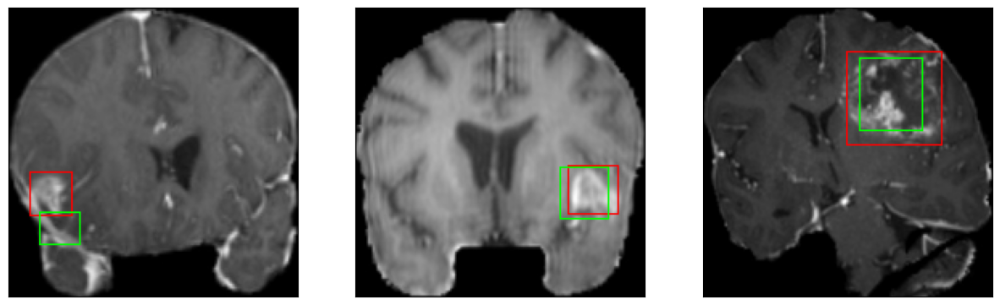

52/52 [==============================] - 9s 165ms/step - loss: 5.6970 - IoU: 0.5560 - val_loss: 8.4590 - val_IoU: 0.4623
Epoch 36/100
8/8 [==============================] - 0s 39ms/step


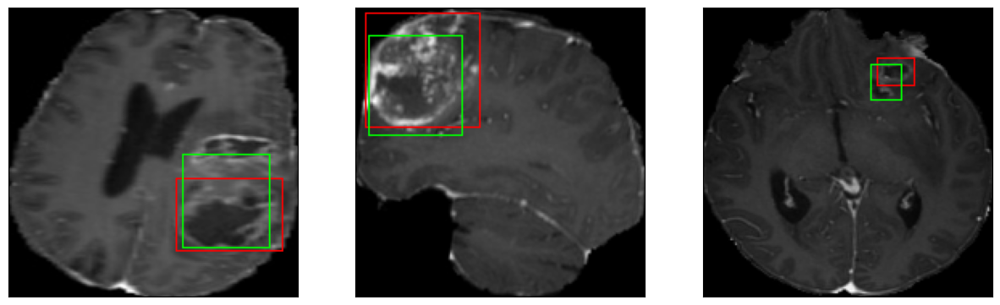

52/52 [==============================] - 7s 140ms/step - loss: 5.6475 - IoU: 0.5670 - val_loss: 7.1597 - val_IoU: 0.5419
Epoch 37/100
8/8 [==============================] - 0s 39ms/step


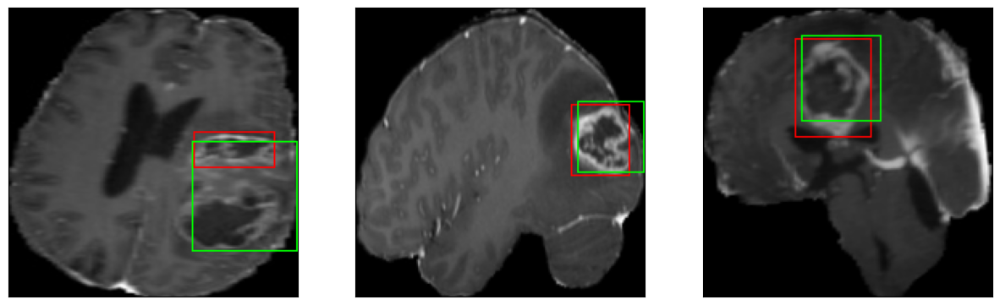

52/52 [==============================] - 8s 145ms/step - loss: 5.5769 - IoU: 0.5717 - val_loss: 6.9479 - val_IoU: 0.5485
Epoch 38/100
8/8 [==============================] - 0s 44ms/step


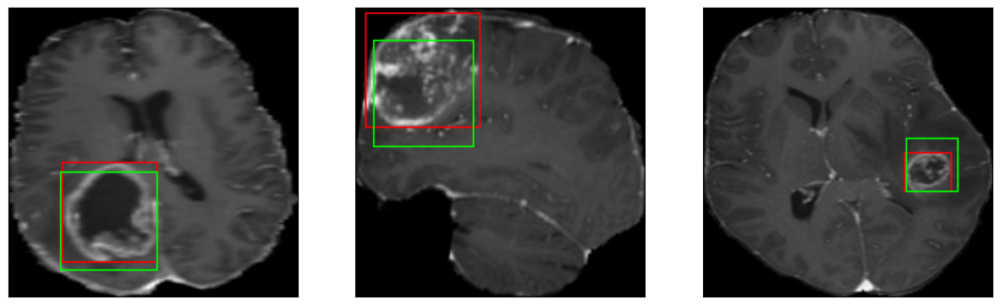

52/52 [==============================] - 9s 173ms/step - loss: 5.7138 - IoU: 0.5665 - val_loss: 6.7972 - val_IoU: 0.5836
Epoch 39/100
8/8 [==============================] - 0s 39ms/step


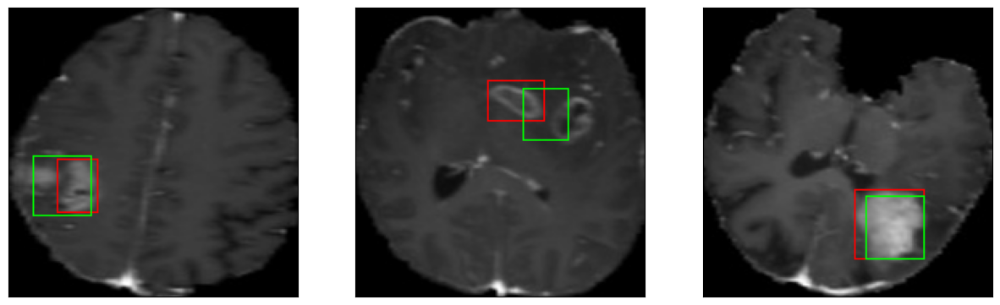

52/52 [==============================] - 7s 142ms/step - loss: 5.6513 - IoU: 0.5724 - val_loss: 6.8887 - val_IoU: 0.5729
Epoch 40/100
8/8 [==============================] - 0s 39ms/step


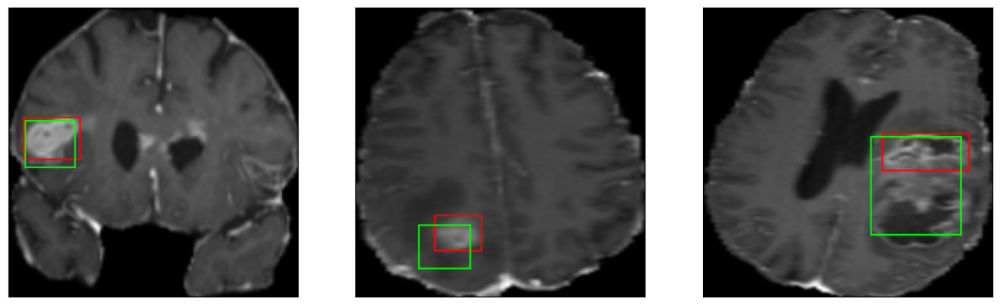

52/52 [==============================] - 8s 160ms/step - loss: 5.6685 - IoU: 0.5731 - val_loss: 6.9080 - val_IoU: 0.5652
Epoch 41/100
8/8 [==============================] - 0s 38ms/step


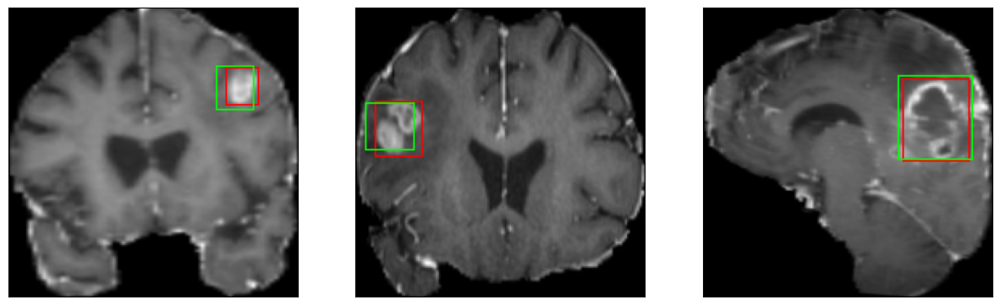

52/52 [==============================] - 8s 150ms/step - loss: 5.5864 - IoU: 0.5731 - val_loss: 7.0346 - val_IoU: 0.5784
Epoch 42/100
8/8 [==============================] - 0s 39ms/step


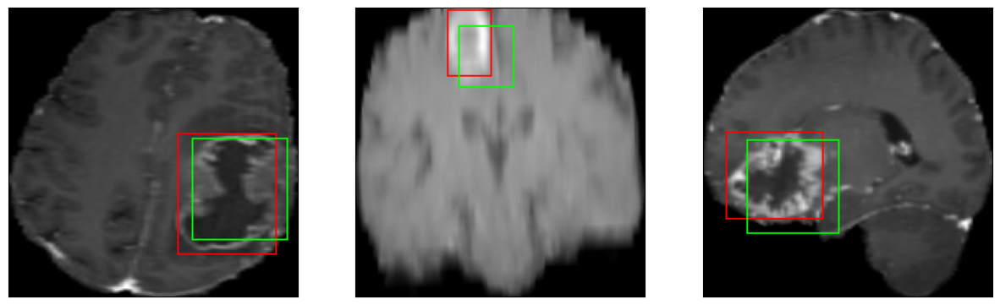

52/52 [==============================] - 8s 149ms/step - loss: 5.5643 - IoU: 0.5723 - val_loss: 8.7609 - val_IoU: 0.4553
Epoch 43/100
8/8 [==============================] - 0s 39ms/step


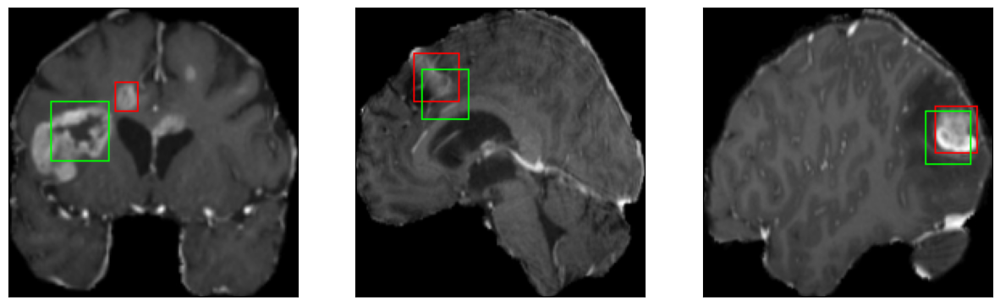

52/52 [==============================] - 8s 150ms/step - loss: 5.5179 - IoU: 0.5856 - val_loss: 6.6011 - val_IoU: 0.5901
Epoch 44/100
8/8 [==============================] - 0s 39ms/step


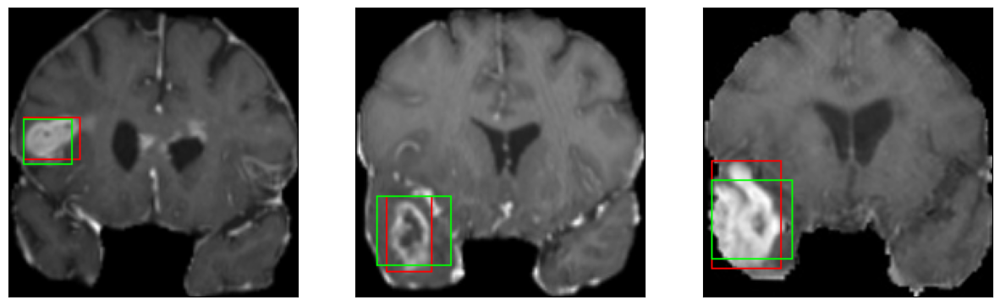

52/52 [==============================] - 8s 153ms/step - loss: 5.4217 - IoU: 0.5876 - val_loss: 7.2719 - val_IoU: 0.5655
Epoch 45/100
8/8 [==============================] - 0s 38ms/step


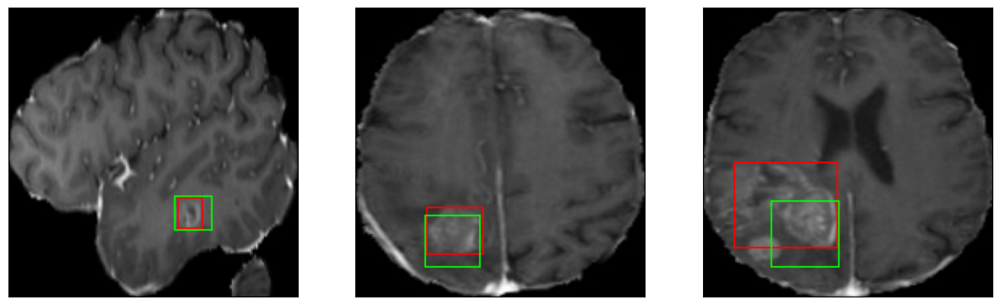

52/52 [==============================] - 8s 157ms/step - loss: 5.3466 - IoU: 0.5864 - val_loss: 7.7880 - val_IoU: 0.5176
Epoch 46/100
8/8 [==============================] - 0s 39ms/step


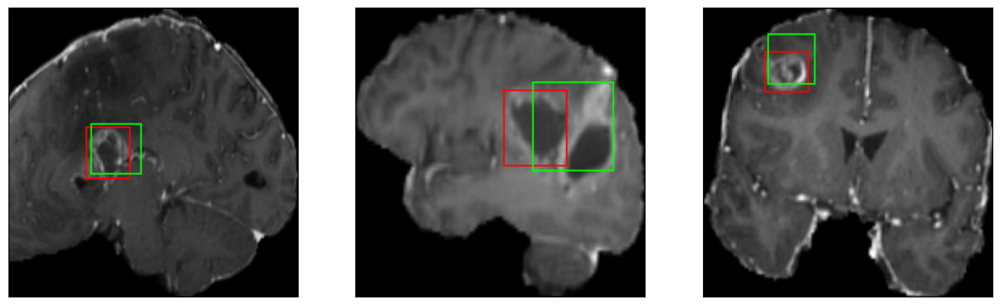

52/52 [==============================] - 8s 147ms/step - loss: 5.3949 - IoU: 0.5929 - val_loss: 7.8702 - val_IoU: 0.5039
Epoch 47/100
8/8 [==============================] - 0s 39ms/step


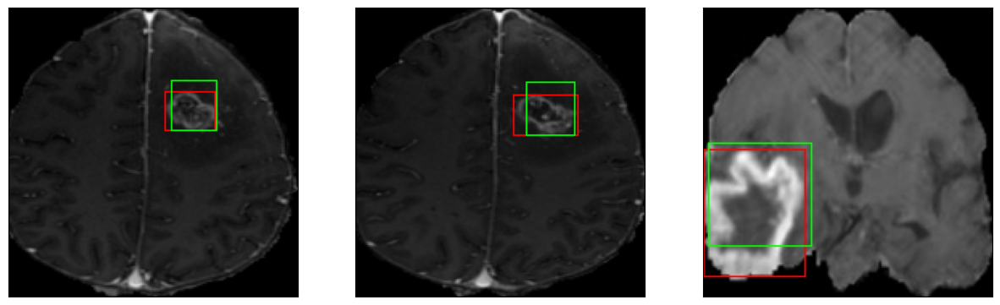

52/52 [==============================] - 8s 161ms/step - loss: 5.2901 - IoU: 0.6002 - val_loss: 6.9096 - val_IoU: 0.5832
Epoch 48/100
8/8 [==============================] - 0s 38ms/step


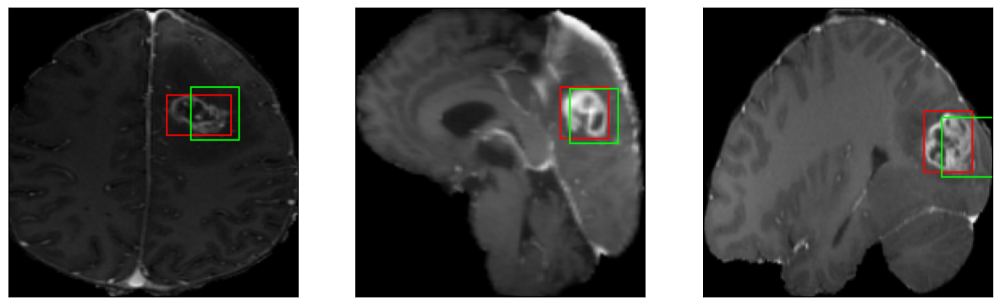

52/52 [==============================] - 8s 149ms/step - loss: 5.2881 - IoU: 0.5999 - val_loss: 7.1930 - val_IoU: 0.5259
Epoch 49/100
8/8 [==============================] - 0s 39ms/step


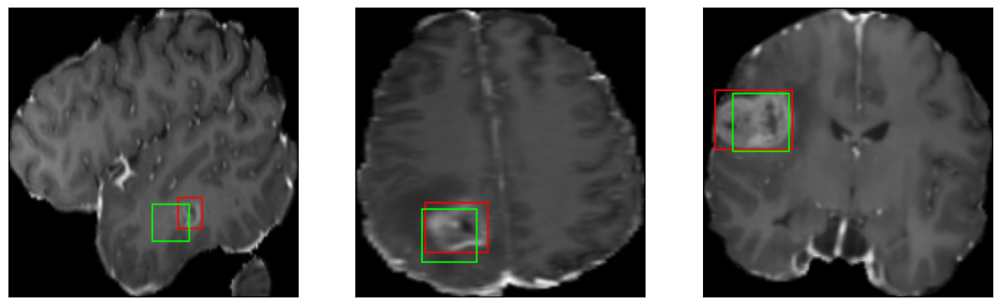

52/52 [==============================] - 7s 142ms/step - loss: 5.2124 - IoU: 0.6027 - val_loss: 6.8031 - val_IoU: 0.5671
Epoch 50/100
8/8 [==============================] - 0s 39ms/step


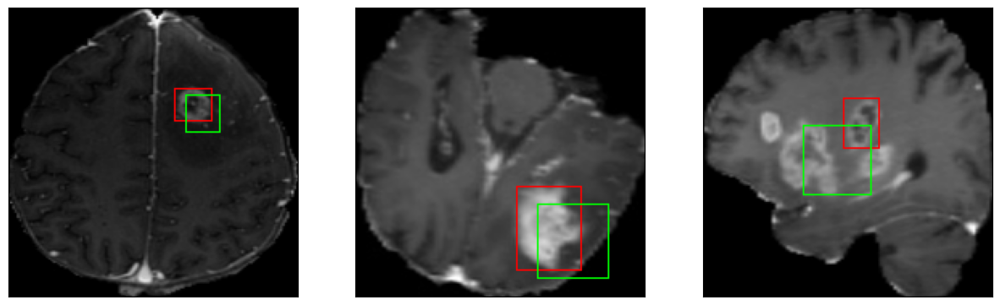

52/52 [==============================] - 8s 163ms/step - loss: 5.3632 - IoU: 0.5932 - val_loss: 8.8838 - val_IoU: 0.4290
Epoch 51/100
8/8 [==============================] - 0s 40ms/step


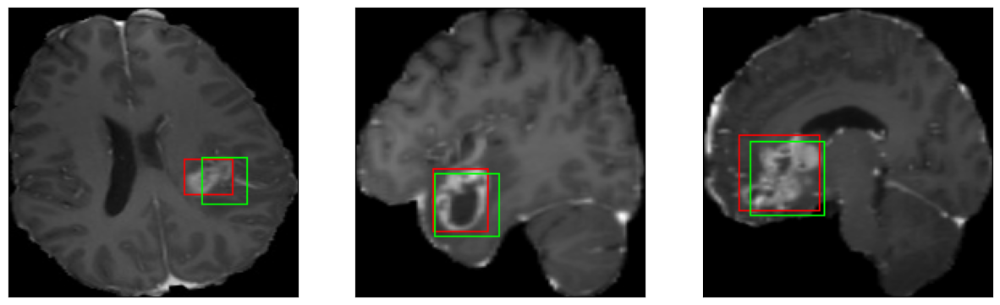

52/52 [==============================] - 7s 144ms/step - loss: 5.2752 - IoU: 0.5968 - val_loss: 7.3003 - val_IoU: 0.5261
Epoch 52/100
8/8 [==============================] - 0s 39ms/step


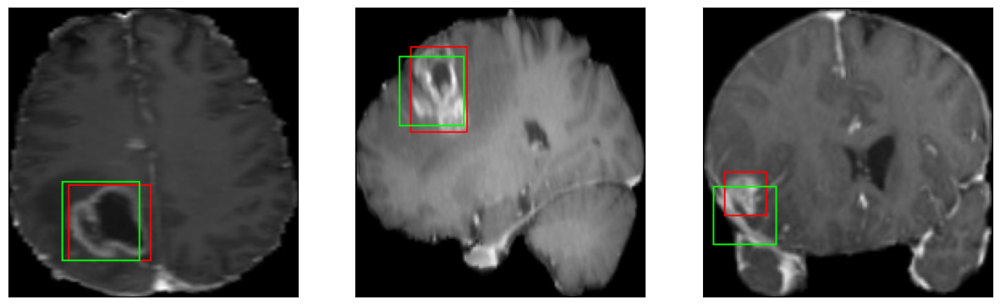

52/52 [==============================] - 8s 158ms/step - loss: 5.3170 - IoU: 0.5965 - val_loss: 7.3532 - val_IoU: 0.5811
Epoch 53/100
8/8 [==============================] - 0s 38ms/step


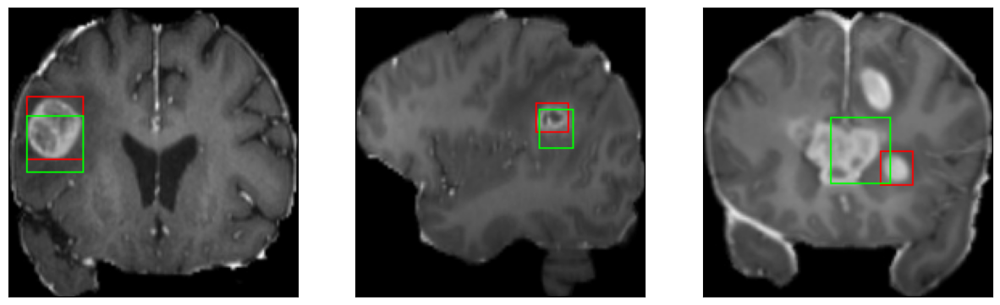

52/52 [==============================] - 8s 151ms/step - loss: 5.3560 - IoU: 0.5912 - val_loss: 8.1049 - val_IoU: 0.4519
Epoch 54/100
8/8 [==============================] - 0s 39ms/step


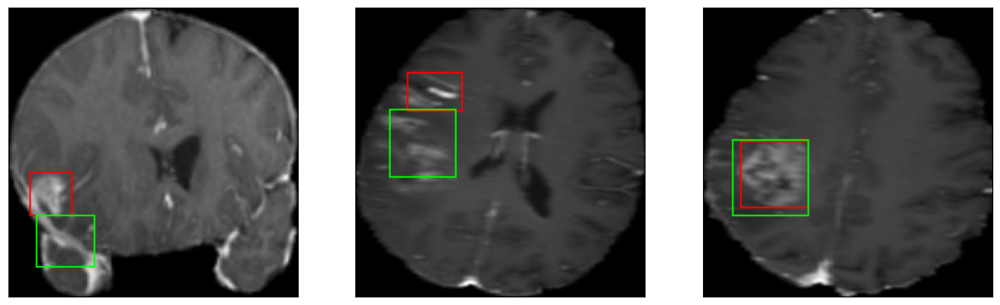

52/52 [==============================] - 8s 152ms/step - loss: 5.1664 - IoU: 0.6043 - val_loss: 7.2871 - val_IoU: 0.5347
Epoch 55/100
8/8 [==============================] - 0s 39ms/step


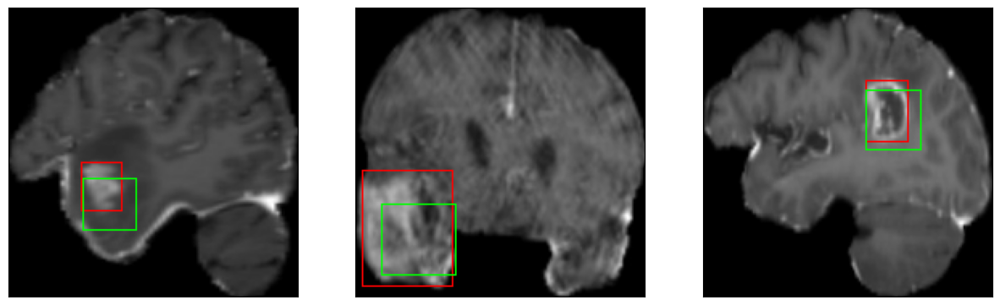

52/52 [==============================] - 9s 166ms/step - loss: 5.1490 - IoU: 0.6042 - val_loss: 7.8324 - val_IoU: 0.4452
Epoch 56/100
8/8 [==============================] - 0s 39ms/step


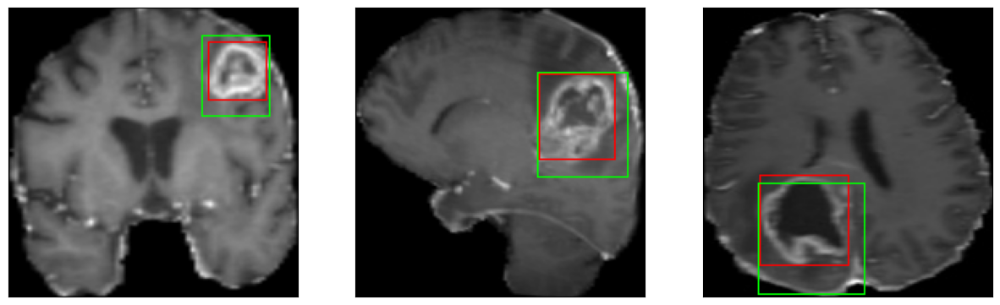

52/52 [==============================] - 8s 145ms/step - loss: 5.1754 - IoU: 0.6035 - val_loss: 8.8475 - val_IoU: 0.5145
Epoch 57/100
8/8 [==============================] - 0s 40ms/step


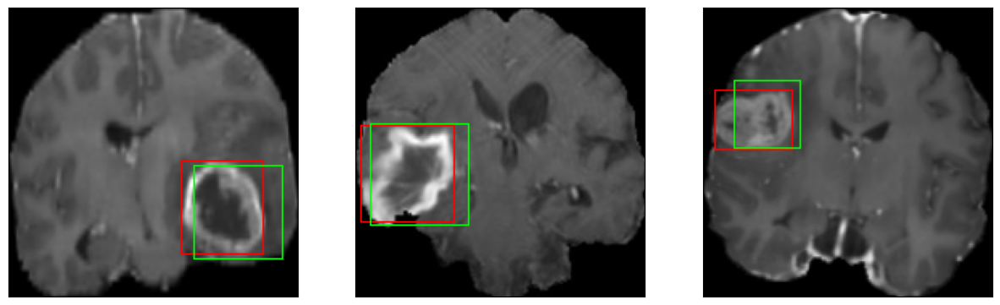

52/52 [==============================] - 8s 162ms/step - loss: 5.2026 - IoU: 0.6020 - val_loss: 7.3798 - val_IoU: 0.5561
Epoch 58/100
8/8 [==============================] - 0s 41ms/step


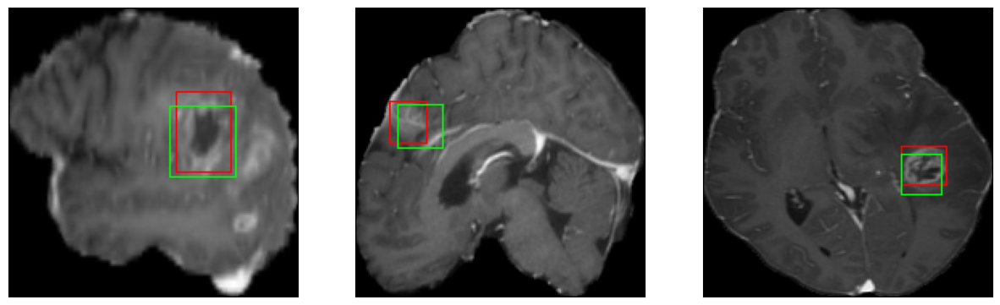

52/52 [==============================] - 8s 152ms/step - loss: 5.3875 - IoU: 0.5947 - val_loss: 7.4104 - val_IoU: 0.5029
Epoch 59/100
8/8 [==============================] - 0s 39ms/step


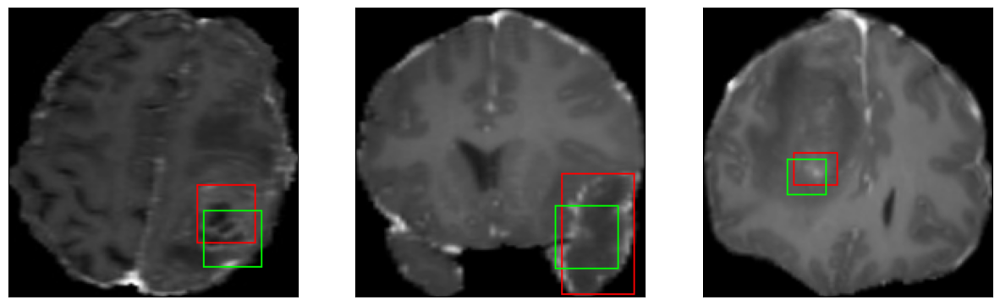

52/52 [==============================] - 8s 153ms/step - loss: 5.1509 - IoU: 0.6139 - val_loss: 7.9006 - val_IoU: 0.4873
Epoch 60/100
8/8 [==============================] - 0s 41ms/step


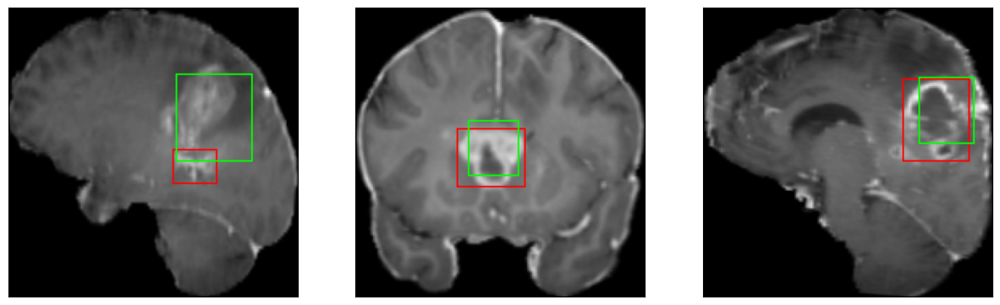

52/52 [==============================] - 8s 159ms/step - loss: 5.2823 - IoU: 0.5892 - val_loss: 7.8798 - val_IoU: 0.4884
Epoch 61/100
8/8 [==============================] - 0s 39ms/step


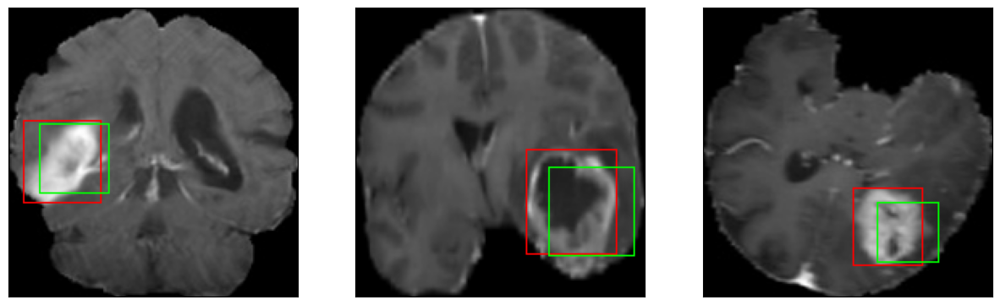

52/52 [==============================] - 7s 145ms/step - loss: 5.0555 - IoU: 0.6145 - val_loss: 7.6426 - val_IoU: 0.4937
Epoch 62/100
8/8 [==============================] - 0s 38ms/step


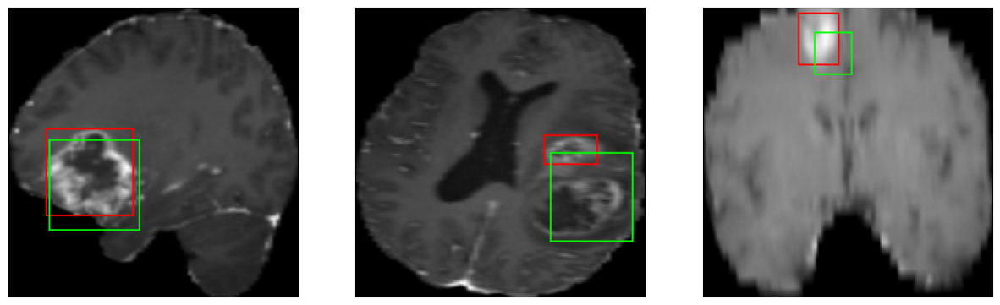

52/52 [==============================] - 8s 162ms/step - loss: 5.0425 - IoU: 0.6145 - val_loss: 7.9286 - val_IoU: 0.4838
Epoch 63/100
8/8 [==============================] - 0s 40ms/step


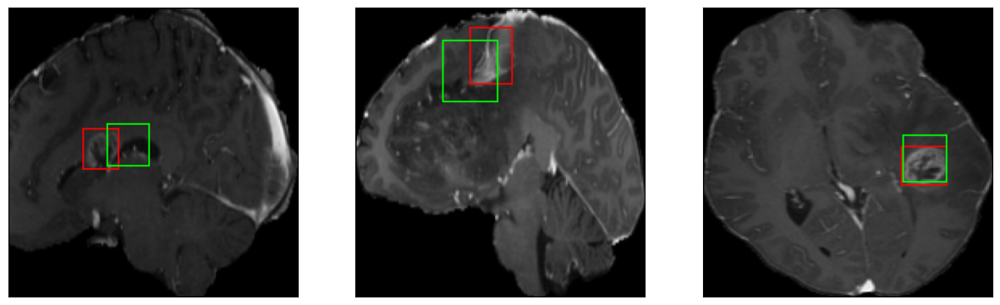

52/52 [==============================] - 8s 154ms/step - loss: 5.1755 - IoU: 0.6063 - val_loss: 6.8808 - val_IoU: 0.5961
Epoch 64/100
8/8 [==============================] - 0s 39ms/step


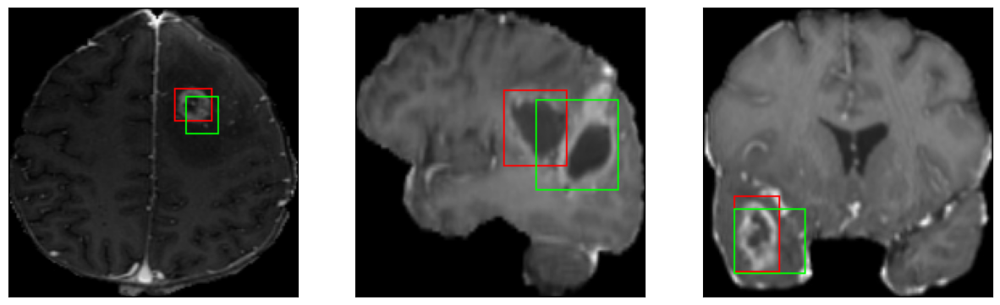

52/52 [==============================] - 8s 158ms/step - loss: 5.2146 - IoU: 0.6080 - val_loss: 7.8889 - val_IoU: 0.4882
Epoch 65/100
8/8 [==============================] - 0s 40ms/step


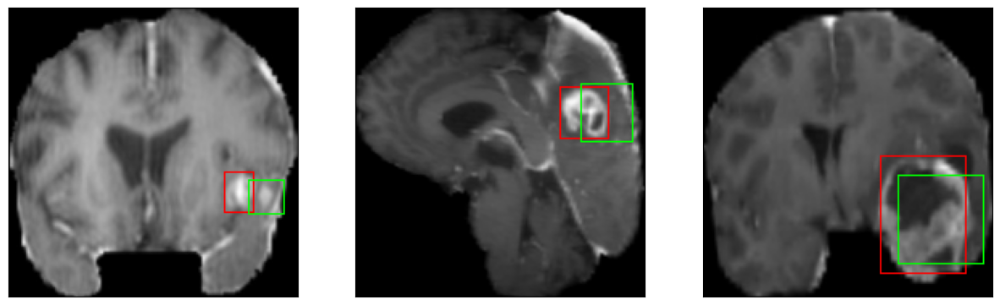

52/52 [==============================] - 9s 167ms/step - loss: 5.2809 - IoU: 0.6060 - val_loss: 7.2755 - val_IoU: 0.5254
Epoch 66/100
8/8 [==============================] - 0s 38ms/step


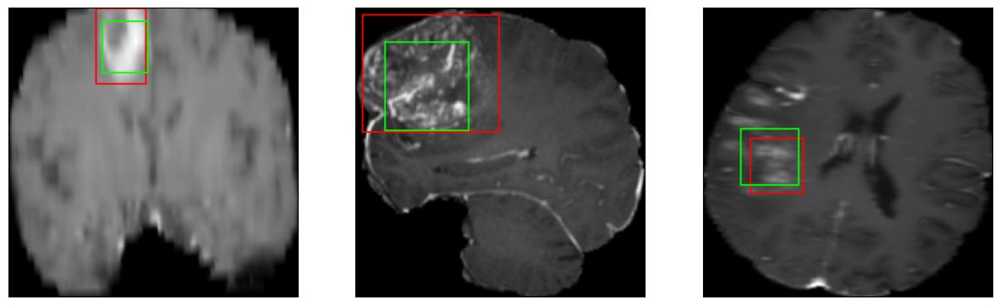

52/52 [==============================] - 8s 144ms/step - loss: 5.1178 - IoU: 0.6045 - val_loss: 7.2127 - val_IoU: 0.5335
Epoch 67/100
8/8 [==============================] - 0s 39ms/step


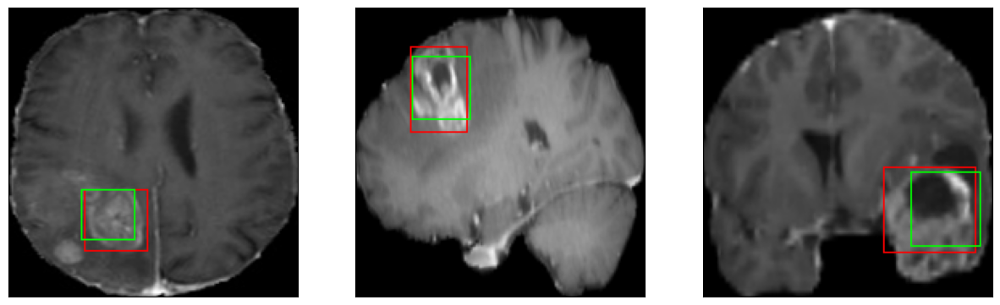

52/52 [==============================] - 9s 167ms/step - loss: 5.1123 - IoU: 0.6080 - val_loss: 7.3451 - val_IoU: 0.5437
Epoch 68/100
8/8 [==============================] - 0s 40ms/step


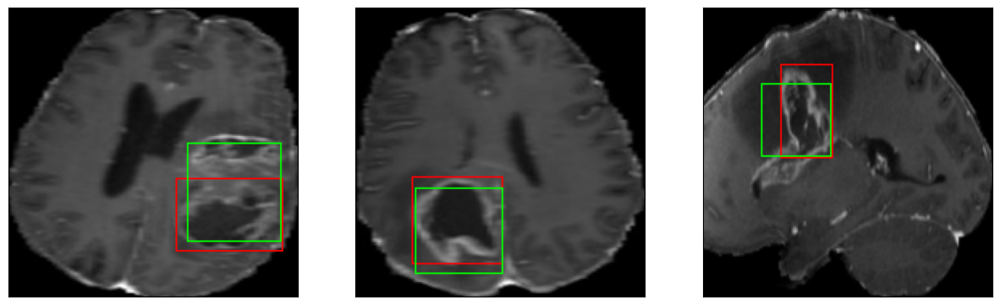

52/52 [==============================] - 8s 160ms/step - loss: 5.2574 - IoU: 0.6014 - val_loss: 7.0751 - val_IoU: 0.5615
Epoch 69/100
8/8 [==============================] - 0s 39ms/step


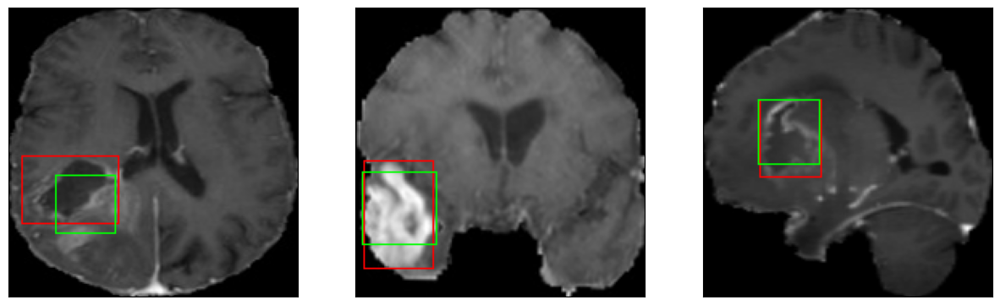

52/52 [==============================] - 8s 146ms/step - loss: 4.9530 - IoU: 0.6104 - val_loss: 6.9280 - val_IoU: 0.5926
Epoch 70/100
8/8 [==============================] - 0s 39ms/step


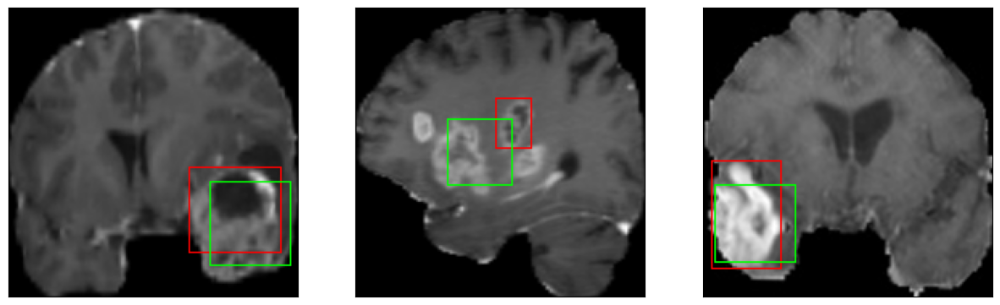

52/52 [==============================] - 8s 158ms/step - loss: 5.0897 - IoU: 0.6110 - val_loss: 7.1583 - val_IoU: 0.5448
Epoch 71/100
8/8 [==============================] - 0s 39ms/step


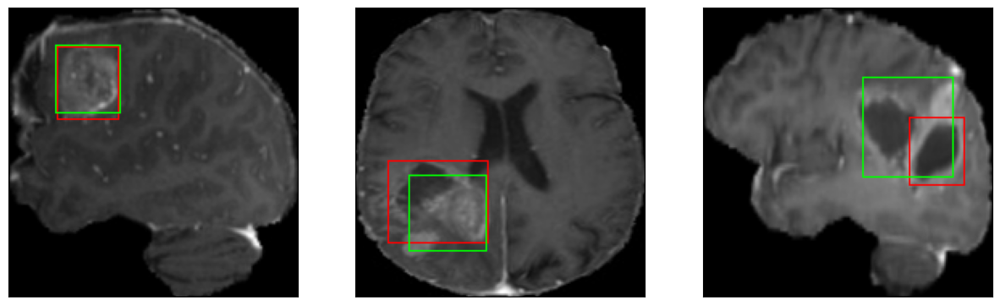

52/52 [==============================] - 8s 145ms/step - loss: 4.8569 - IoU: 0.6224 - val_loss: 6.4661 - val_IoU: 0.6008
Epoch 72/100
8/8 [==============================] - 0s 40ms/step


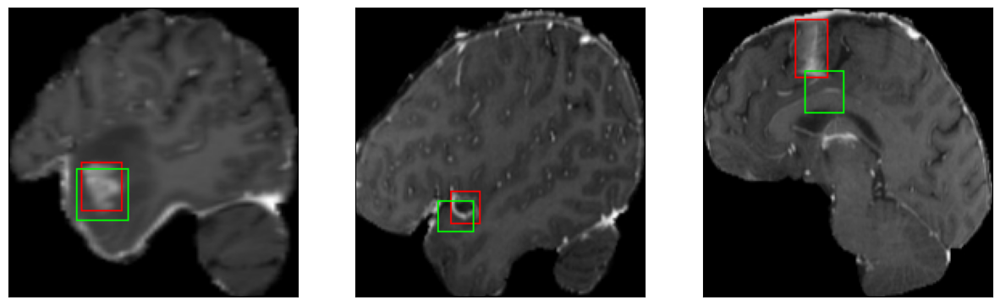

52/52 [==============================] - 8s 157ms/step - loss: 5.2436 - IoU: 0.6063 - val_loss: 6.5993 - val_IoU: 0.5920
Epoch 73/100
8/8 [==============================] - 0s 41ms/step


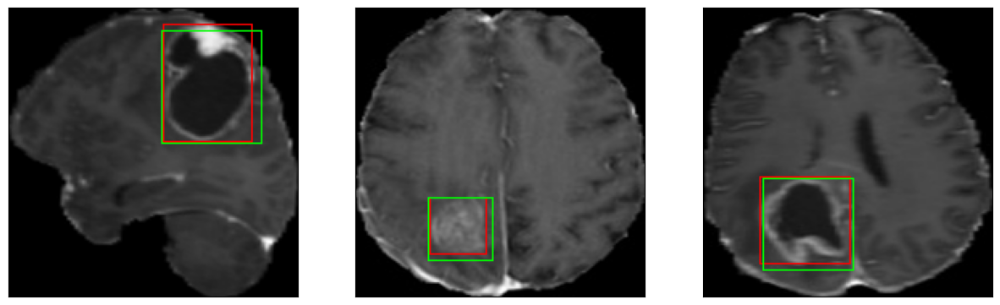

52/52 [==============================] - 9s 165ms/step - loss: 5.1900 - IoU: 0.6013 - val_loss: 7.5629 - val_IoU: 0.5616
Epoch 74/100
8/8 [==============================] - 0s 39ms/step


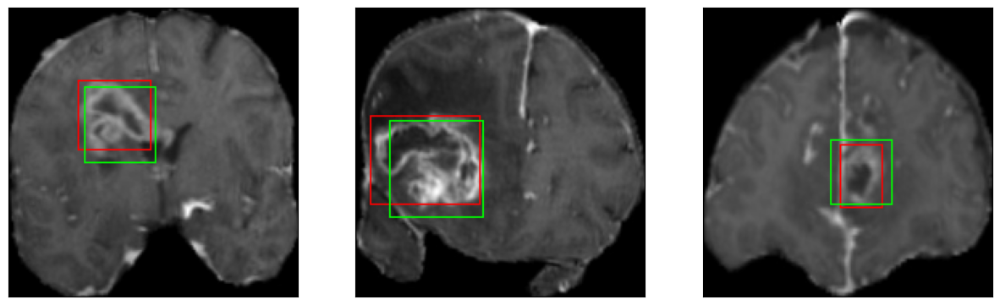

52/52 [==============================] - 8s 150ms/step - loss: 4.8734 - IoU: 0.6204 - val_loss: 7.1705 - val_IoU: 0.5376
Epoch 75/100
8/8 [==============================] - 0s 38ms/step


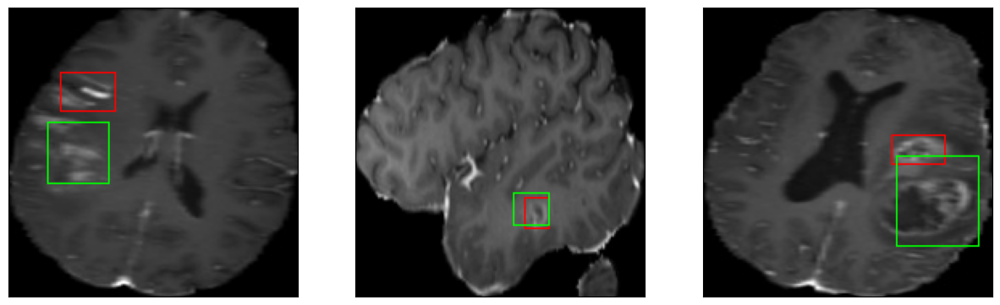

52/52 [==============================] - 8s 159ms/step - loss: 4.9862 - IoU: 0.6225 - val_loss: 7.6578 - val_IoU: 0.5396
Epoch 76/100
8/8 [==============================] - 0s 39ms/step


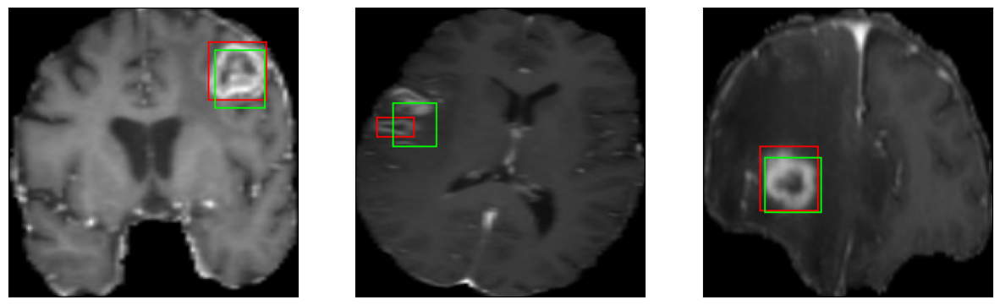

52/52 [==============================] - 8s 153ms/step - loss: 4.8227 - IoU: 0.6321 - val_loss: 8.0403 - val_IoU: 0.4756
Epoch 77/100
8/8 [==============================] - 0s 39ms/step


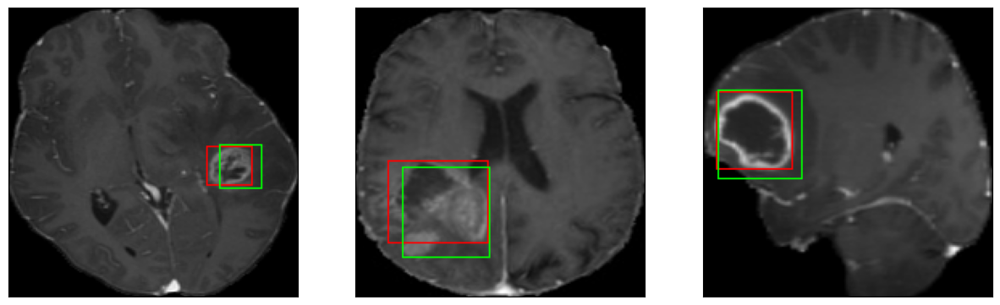

52/52 [==============================] - 8s 152ms/step - loss: 5.0799 - IoU: 0.6087 - val_loss: 7.2041 - val_IoU: 0.5263
Epoch 78/100
8/8 [==============================] - 0s 40ms/step


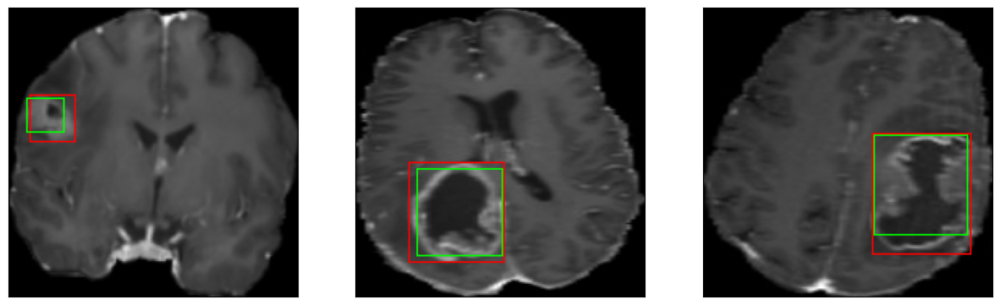

52/52 [==============================] - 8s 154ms/step - loss: 5.0258 - IoU: 0.6149 - val_loss: 7.1413 - val_IoU: 0.5693
Epoch 79/100
8/8 [==============================] - 0s 39ms/step


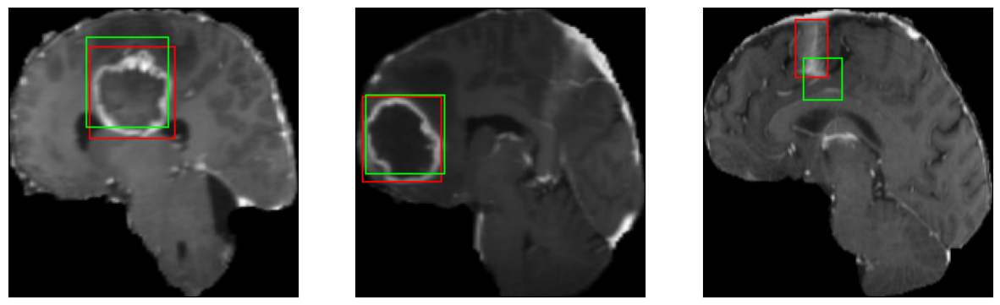

52/52 [==============================] - 8s 147ms/step - loss: 4.9802 - IoU: 0.6165 - val_loss: 6.8549 - val_IoU: 0.5560
Epoch 80/100
8/8 [==============================] - 0s 39ms/step


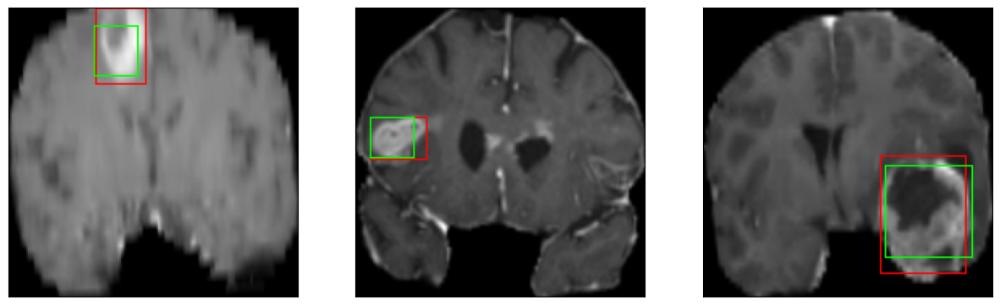

52/52 [==============================] - 8s 158ms/step - loss: 5.0357 - IoU: 0.6199 - val_loss: 6.9484 - val_IoU: 0.5724
Epoch 81/100
8/8 [==============================] - 0s 39ms/step


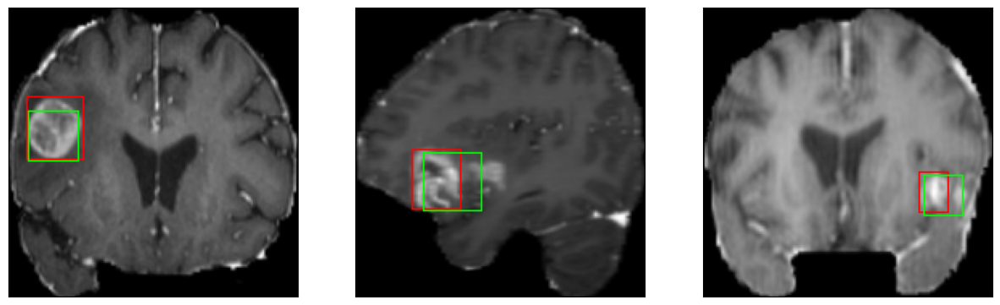

52/52 [==============================] - 8s 158ms/step - loss: 5.2042 - IoU: 0.6027 - val_loss: 7.6566 - val_IoU: 0.5162
Epoch 82/100
8/8 [==============================] - 0s 40ms/step


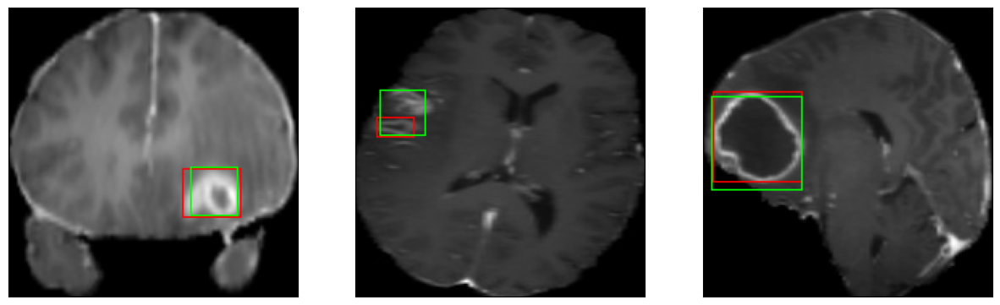

52/52 [==============================] - 8s 146ms/step - loss: 4.9799 - IoU: 0.6187 - val_loss: 6.8175 - val_IoU: 0.5991
Epoch 83/100
8/8 [==============================] - 0s 39ms/step


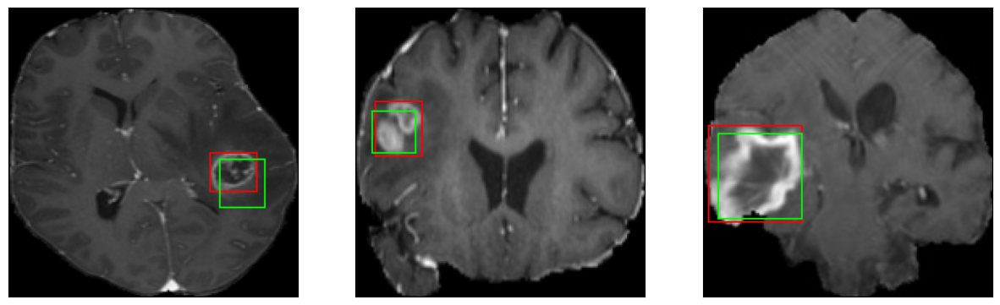

52/52 [==============================] - 8s 158ms/step - loss: 4.9362 - IoU: 0.6202 - val_loss: 7.8084 - val_IoU: 0.5033
Epoch 84/100
8/8 [==============================] - 0s 38ms/step


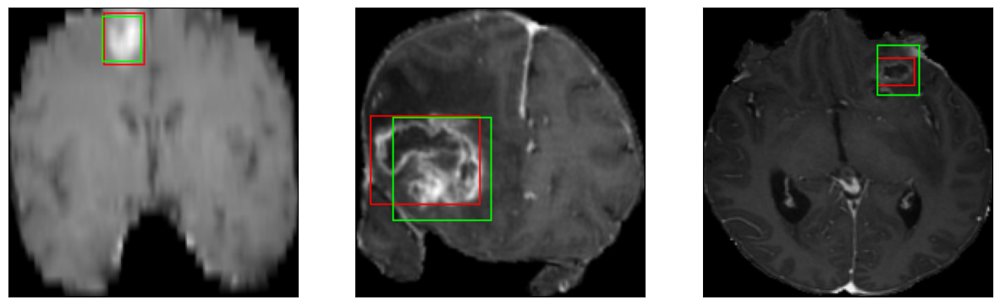

52/52 [==============================] - 8s 146ms/step - loss: 4.8946 - IoU: 0.6221 - val_loss: 7.5776 - val_IoU: 0.5433
Epoch 85/100
8/8 [==============================] - 0s 39ms/step


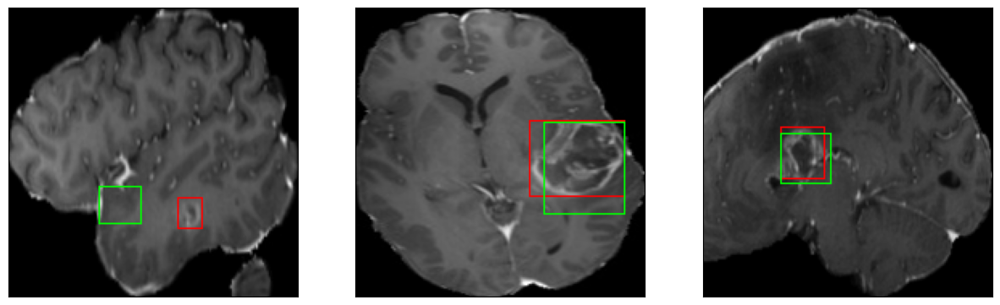

52/52 [==============================] - 8s 158ms/step - loss: 4.8808 - IoU: 0.6212 - val_loss: 8.3237 - val_IoU: 0.4774
Epoch 86/100
8/8 [==============================] - 0s 39ms/step


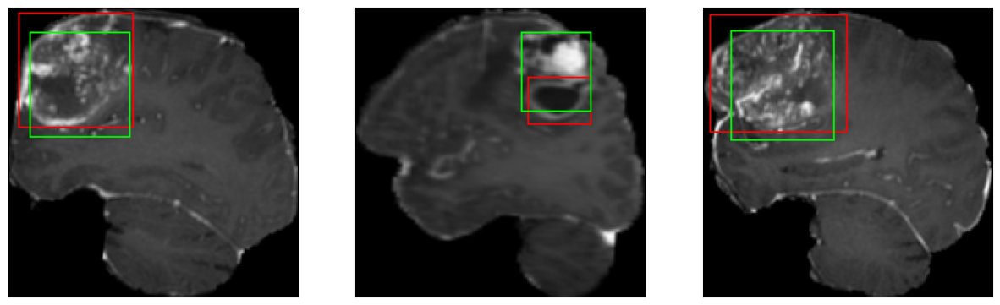

52/52 [==============================] - 8s 146ms/step - loss: 4.9120 - IoU: 0.6217 - val_loss: 6.6142 - val_IoU: 0.5699
Epoch 87/100
8/8 [==============================] - 0s 39ms/step


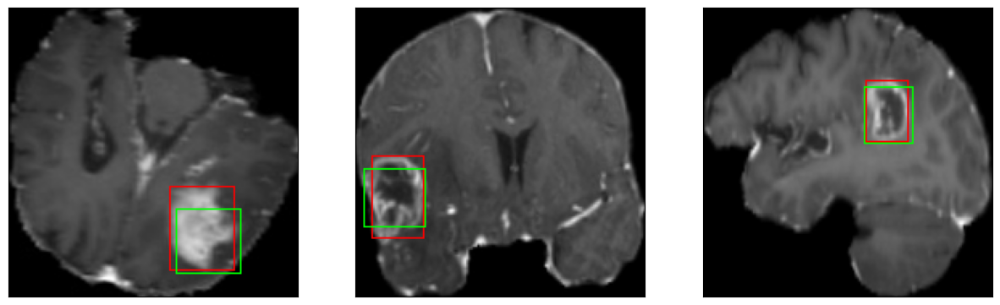

52/52 [==============================] - 8s 148ms/step - loss: 4.9445 - IoU: 0.6149 - val_loss: 7.5504 - val_IoU: 0.5080
Epoch 88/100
8/8 [==============================] - 0s 42ms/step


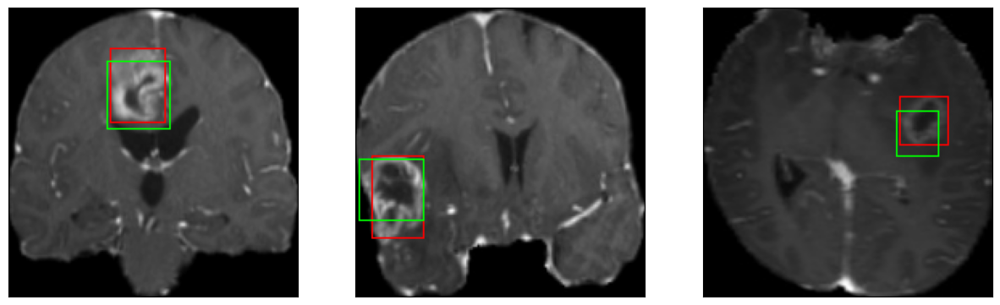

52/52 [==============================] - 8s 155ms/step - loss: 4.9778 - IoU: 0.6167 - val_loss: 6.8460 - val_IoU: 0.5590
Epoch 89/100
8/8 [==============================] - 0s 39ms/step


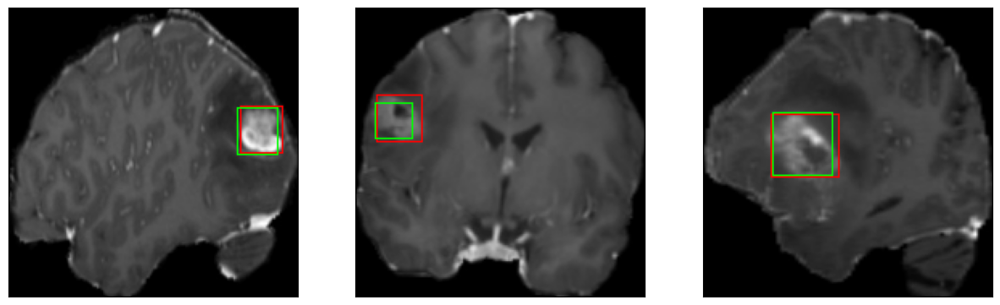

52/52 [==============================] - 8s 145ms/step - loss: 4.7959 - IoU: 0.6245 - val_loss: 6.8063 - val_IoU: 0.5880
Epoch 90/100
8/8 [==============================] - 0s 39ms/step


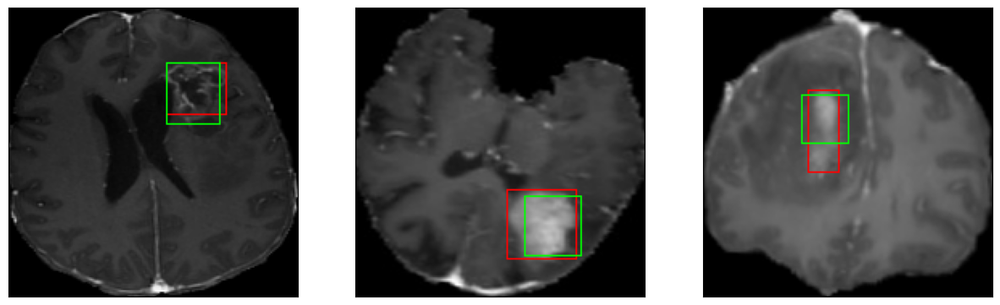

52/52 [==============================] - 8s 163ms/step - loss: 4.7653 - IoU: 0.6289 - val_loss: 6.7196 - val_IoU: 0.5692
Epoch 91/100
8/8 [==============================] - 0s 39ms/step


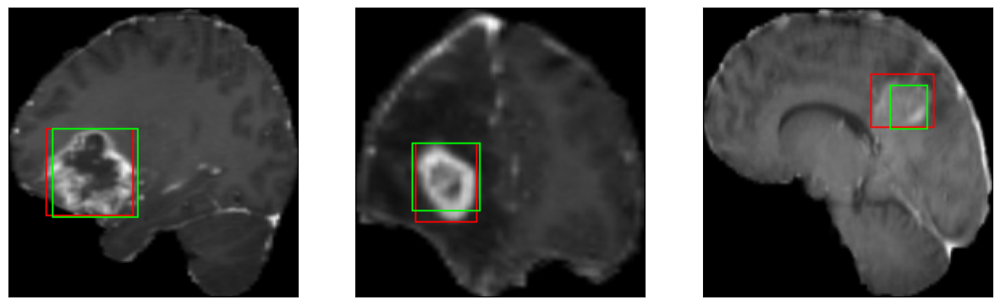

52/52 [==============================] - 7s 144ms/step - loss: 4.7494 - IoU: 0.6251 - val_loss: 6.9050 - val_IoU: 0.5864
Epoch 92/100
8/8 [==============================] - 0s 39ms/step


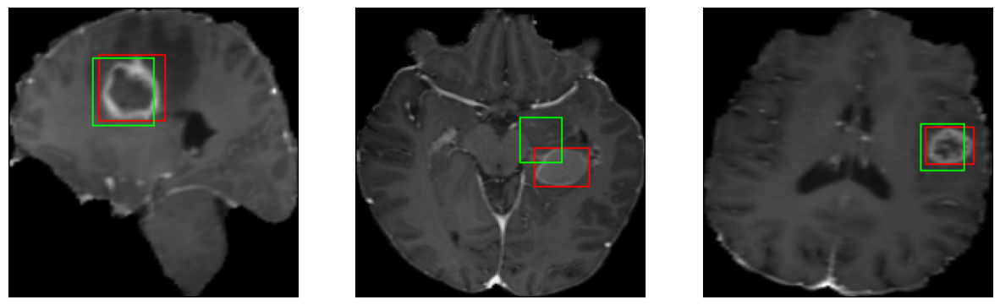

52/52 [==============================] - 8s 154ms/step - loss: 4.8918 - IoU: 0.6212 - val_loss: 7.3534 - val_IoU: 0.5504
Epoch 93/100
8/8 [==============================] - 0s 42ms/step


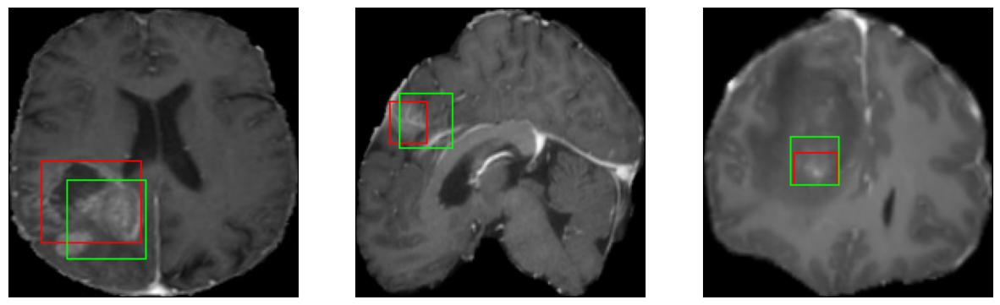

52/52 [==============================] - 9s 165ms/step - loss: 4.8153 - IoU: 0.6286 - val_loss: 7.0221 - val_IoU: 0.5632
Epoch 94/100
8/8 [==============================] - 0s 39ms/step


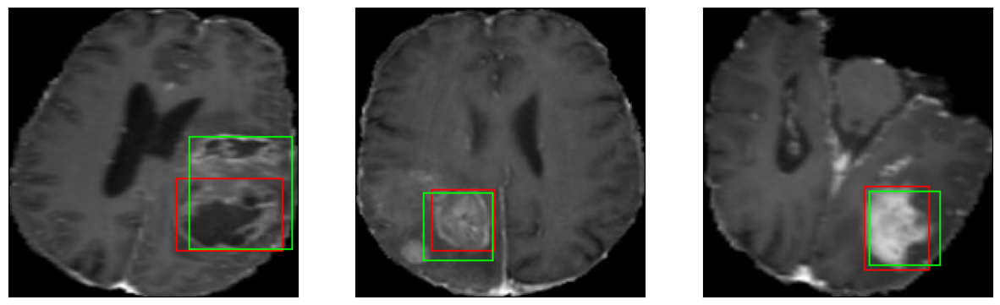

52/52 [==============================] - 8s 147ms/step - loss: 4.7564 - IoU: 0.6315 - val_loss: 6.6753 - val_IoU: 0.5941
Epoch 95/100
8/8 [==============================] - 0s 41ms/step


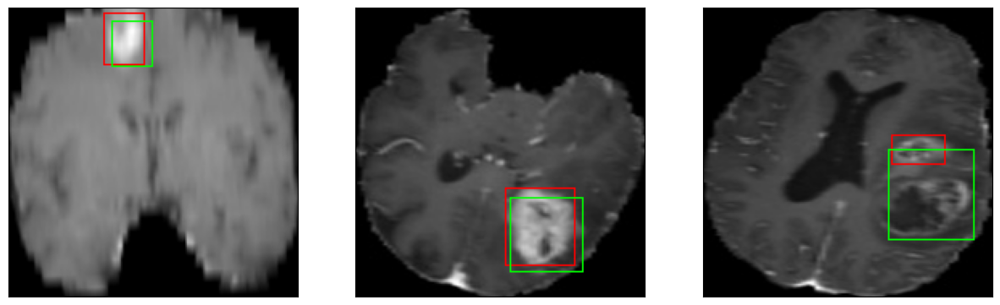

52/52 [==============================] - 8s 160ms/step - loss: 4.6914 - IoU: 0.6316 - val_loss: 7.2357 - val_IoU: 0.5433
Epoch 96/100
8/8 [==============================] - 0s 38ms/step


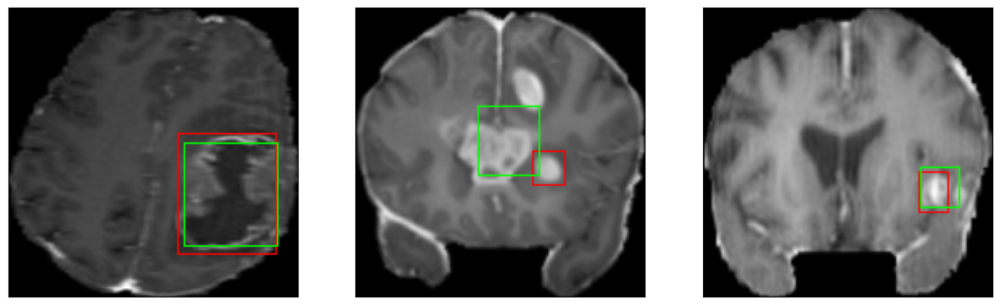

52/52 [==============================] - 8s 156ms/step - loss: 4.6788 - IoU: 0.6322 - val_loss: 6.8160 - val_IoU: 0.5921
Epoch 97/100
8/8 [==============================] - 0s 39ms/step


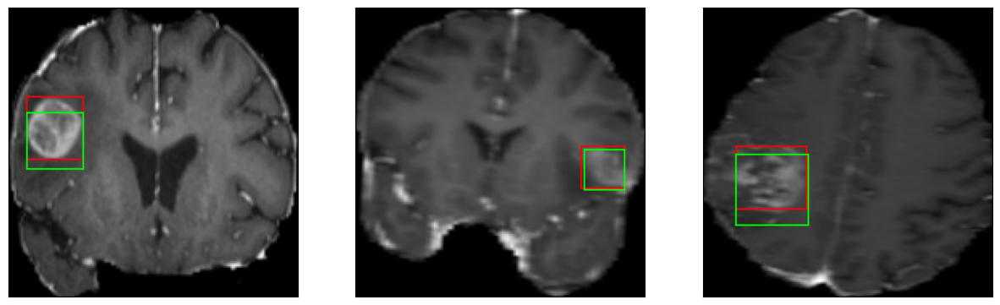

52/52 [==============================] - 8s 160ms/step - loss: 4.8774 - IoU: 0.6207 - val_loss: 7.3908 - val_IoU: 0.5376
Epoch 98/100
8/8 [==============================] - 0s 39ms/step


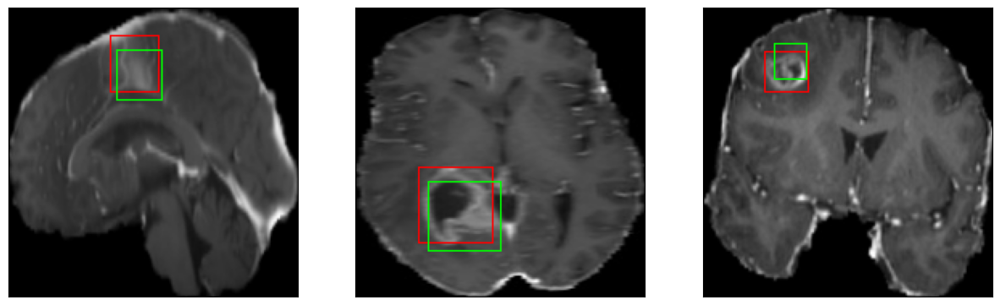

52/52 [==============================] - 8s 146ms/step - loss: 4.6997 - IoU: 0.6316 - val_loss: 7.3022 - val_IoU: 0.5468
Epoch 99/100
8/8 [==============================] - 0s 39ms/step


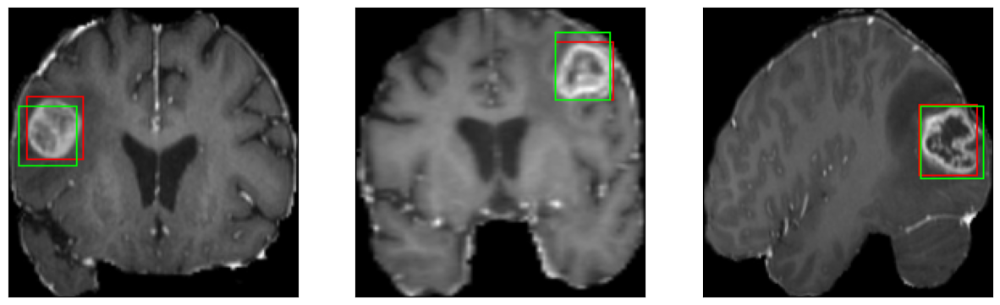

52/52 [==============================] - 8s 155ms/step - loss: 4.7768 - IoU: 0.6238 - val_loss: 7.3959 - val_IoU: 0.5538
Epoch 100/100
8/8 [==============================] - 0s 41ms/step


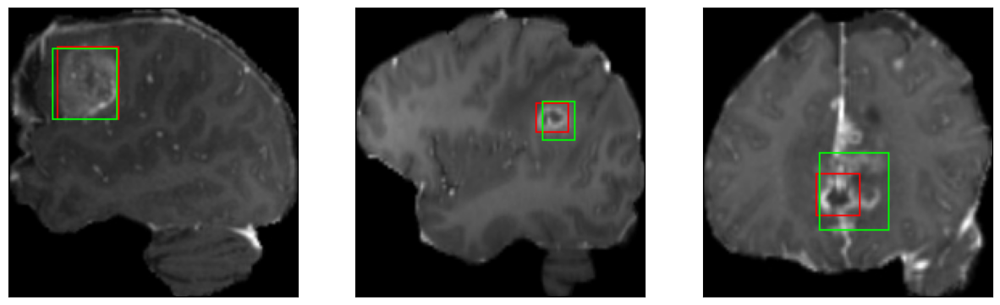

52/52 [==============================] - 8s 151ms/step - loss: 4.6824 - IoU: 0.6332 - val_loss: 6.8121 - val_IoU: 0.6024


In [23]:
model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [24]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
        
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])


In [27]:
model.evaluate(test_dataset)

15/15 [==============================] - 1s 32ms/step - loss: 5.7800 - IoU: 0.6257


[5.7800211906433105, 0.6256693005561829]